# Goal

Jacobo de la Cuesta-Zuluaga, January 2020.

The aim of this notebook is to assess the abundance of *Methanomassiliicoccales* in multiple human populations

# Init

In [1]:
library(propr)
library(zCompositions)
library(tidyverse)
library(vegan)
library(data.table)
library(cowplot)
library(phyloseq)
library(speedyseq)
library(cooccur)
library(vegan)
library(furrr)
library(RColorBrewer)
library(lmerTest)
library(igraph)

Loading required package: MASS
Loading required package: NADA
Loading required package: survival

Attaching package: ‘NADA’

The following object is masked from ‘package:stats’:

    cor

Loading required package: truncnorm
── Attaching packages ─────────────────────────────────────── tidyverse 1.2.1 ──
✔ ggplot2 3.2.1     ✔ purrr   0.3.2
✔ tibble  2.1.3     ✔ dplyr   0.8.3
✔ tidyr   0.8.3     ✔ stringr 1.4.0
✔ readr   1.3.1     ✔ forcats 0.4.0
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter()   masks stats::filter()
✖ dplyr::lag()      masks stats::lag()
✖ dplyr::select()   masks MASS::select()
✖ purrr::simplify() masks propr::simplify()
Loading required package: permute
Loading required package: lattice

Attaching package: ‘lattice’

The following object is masked from ‘package:propr’:

    parallel

This is vegan 2.5-5

Attaching package: ‘data.table’

The following objects are masked from ‘package:dplyr’:

    between, first, last

T

In [2]:
# R util functions
source("/ebio/abt3_projects/vadinCA11/data/V11/R_utils/utils.R")

In [3]:
# Functions
# Extract phyloseq table as df
extract_phyloseq = function(physeq_obj){
    physeq_table = physeq_obj@`.Data`
    rownames(physeq_table) = NULL
    return(as.data.frame(physeq_table))
}

In [4]:
# Multicore
# options(future.globals.maxSize = 1000 * 1024^2)
plan(multisession, workers = 25)

# Var

## Metadata

In [5]:
# Load metadata and remove duplicates
GM_metadata_raw = "/ebio/abt3_projects/columbian_gut_metagenome/data/metadata/Global_metagenomes_Metadata.csv" %>%
    read_tsv() %>%
    distinct()

Parsed with column specification:
cols(
  .default = col_logical(),
  dataset_name = col_character(),
  Sample = col_character(),
  subjectID = col_character(),
  disease = col_character(),
  age = col_double(),
  gender = col_character(),
  country = col_character(),
  non_westernized = col_character(),
  BMI = col_double(),
  disease_subtype = col_character(),
  hdl = col_double(),
  triglycerides = col_double(),
  hba1c = col_double(),
  ldl = col_double(),
  cholesterol = col_double(),
  glucose = col_double(),
  creatinine = col_double(),
  location = col_character(),
  dyastolic_p = col_double(),
  systolic_p = col_double()
  # ... with 1 more columns
)
See spec(...) for full column specifications.
Warning message:
“2871 parsing failures.
 row    col           expected actual                                                                                         file
1071 smoker 1/0/T/F/TRUE/FALSE     no '/ebio/abt3_projects/columbian_gut_metagenome/data/metadata/Global_metagenom

In [6]:
# Remove HuBif
HuBif_samples = GM_metadata_raw %>%
    filter(dataset_name == "HuBif") %>%
    pull(Sample)

GM_metadata_raw = GM_metadata_raw %>%
    filter(dataset_name != "HuBif")

## Tax profile table

In [7]:
# Load Bracken files
# directory
GM_profiles_dir = "/ebio/abt3_projects/databases_no-backup/curatedMetagenomicData/global_metagenomes/combined_GTDBr86/profiles/kraken"

GM_bracken_raw = file.path(GM_profiles_dir, "all-combined-bracken.tsv") %>%
    fread(., data.table=FALSE)

In [8]:
GM_bracken_raw[1:10, 1:10]

name,taxonomy_id,taxonomy_lvl,taxonomy,taxIDs,SAMEA5814677_num,SAMEA5814677_frac,SAMEA5814637_num,SAMEA5814637_frac,SAMEA5814789_num
<chr>,<int>,<chr>,<chr>,<chr>,<int>,<dbl>,<int>,<dbl>,<int>
Pedobacter sp. AJM,2003629,S,Bacteria;Bacteroidetes;Sphingobacteriia;Sphingobacteriales;Sphingobacteriaceae;Pedobacter;Pedobacter sp. AJM,131567;2;1783270;68336;976;117747;200666;84566;84567;2003629,0,0e+00,0,0e+00,0
Bradyrhizobium sp. Ghvi,1855319,S,Bacteria;Proteobacteria;Alphaproteobacteria;Rhizobiales;Bradyrhizobiaceae;Bradyrhizobium;Bradyrhizobium sp. Ghvi,131567;2;1224;28211;356;41294;374;1855319,0,0e+00,0,0e+00,0
Maribacter sp. 1_2014MBL_MicDiv,1644130,S,Bacteria;Bacteroidetes;Flavobacteriia;Flavobacteriales;Flavobacteriaceae;Maribacter;Maribacter sp. 1_2014MBL_MicDiv,131567;2;1783270;68336;976;117743;200644;49546;252356;1644130,0,0e+00,0,0e+00,0
Streptomyces ochraceiscleroticus,47761,S,Bacteria;Actinobacteria;Actinobacteria;Streptomycetales;Streptomycetaceae;Streptomyces;Streptomyces ochraceiscleroticus,131567;2;1783272;201174;1760;85011;2062;1883;47761,0,0e+00,0,0e+00,0
Selenomonas bovis,416586,S,Bacteria;Firmicutes;Negativicutes;Selenomonadales;Selenomonadaceae;Selenomonas;Selenomonas bovis,131567;2;1783272;1239;909932;909929;1843491;970;416586,0,0e+00,0,0e+00,0
Arthrobacter sp. Leaf337,1736342,S,Bacteria;Actinobacteria;Actinobacteria;Micrococcales;Micrococcaceae;Arthrobacter;Arthrobacter sp. Leaf337,131567;2;1783272;201174;1760;85006;1268;1663;1736342,0,0e+00,0,0e+00,0
Eubacterium sp. CAG:38,1262889,S,Bacteria;Firmicutes;Clostridia;Clostridiales;Eubacteriaceae;Eubacterium;Eubacterium sp. CAG:38,131567;2;1783272;1239;186801;186802;186806;1730;84372;1262889,924,9e-05,1490,6e-05,2933
Lactobacillus secaliphilus,396268,S,Bacteria;Firmicutes;Bacilli;Lactobacillales;Lactobacillaceae;Lactobacillus;Lactobacillus secaliphilus,131567;2;1783272;1239;91061;186826;33958;1578;396268,0,0e+00,0,0e+00,0
Tissierella sp. P1,1280483,S,Bacteria;Firmicutes;Tissierellia;Tissierellales;Tissierellaceae;Tissierella;Tissierella sp. P1,131567;2;1783272;1239;1737404;1737405;1737406;41273;1280483,325,3e-05,0,0e+00,0


In [9]:
# Create a tax information data frame
GM_tax_complete = GM_bracken_raw %>% 
    mutate(taxonomy_id = str_c("TID", taxonomy_id)) %>%
    select(c("name", "taxonomy_id", "taxonomy_lvl", "taxonomy", "taxIDs"))
GM_tax_complete

name,taxonomy_id,taxonomy_lvl,taxonomy,taxIDs
<chr>,<chr>,<chr>,<chr>,<chr>
Pedobacter sp. AJM,TID2003629,S,Bacteria;Bacteroidetes;Sphingobacteriia;Sphingobacteriales;Sphingobacteriaceae;Pedobacter;Pedobacter sp. AJM,131567;2;1783270;68336;976;117747;200666;84566;84567;2003629
Bradyrhizobium sp. Ghvi,TID1855319,S,Bacteria;Proteobacteria;Alphaproteobacteria;Rhizobiales;Bradyrhizobiaceae;Bradyrhizobium;Bradyrhizobium sp. Ghvi,131567;2;1224;28211;356;41294;374;1855319
Maribacter sp. 1_2014MBL_MicDiv,TID1644130,S,Bacteria;Bacteroidetes;Flavobacteriia;Flavobacteriales;Flavobacteriaceae;Maribacter;Maribacter sp. 1_2014MBL_MicDiv,131567;2;1783270;68336;976;117743;200644;49546;252356;1644130
Streptomyces ochraceiscleroticus,TID47761,S,Bacteria;Actinobacteria;Actinobacteria;Streptomycetales;Streptomycetaceae;Streptomyces;Streptomyces ochraceiscleroticus,131567;2;1783272;201174;1760;85011;2062;1883;47761
Selenomonas bovis,TID416586,S,Bacteria;Firmicutes;Negativicutes;Selenomonadales;Selenomonadaceae;Selenomonas;Selenomonas bovis,131567;2;1783272;1239;909932;909929;1843491;970;416586
Arthrobacter sp. Leaf337,TID1736342,S,Bacteria;Actinobacteria;Actinobacteria;Micrococcales;Micrococcaceae;Arthrobacter;Arthrobacter sp. Leaf337,131567;2;1783272;201174;1760;85006;1268;1663;1736342
Eubacterium sp. CAG:38,TID1262889,S,Bacteria;Firmicutes;Clostridia;Clostridiales;Eubacteriaceae;Eubacterium;Eubacterium sp. CAG:38,131567;2;1783272;1239;186801;186802;186806;1730;84372;1262889
Lactobacillus secaliphilus,TID396268,S,Bacteria;Firmicutes;Bacilli;Lactobacillales;Lactobacillaceae;Lactobacillus;Lactobacillus secaliphilus,131567;2;1783272;1239;91061;186826;33958;1578;396268
Tissierella sp. P1,TID1280483,S,Bacteria;Firmicutes;Tissierellia;Tissierellales;Tissierellaceae;Tissierella;Tissierella sp. P1,131567;2;1783272;1239;1737404;1737405;1737406;41273;1280483


In [10]:
tax_levels = c("Domain", "Phylum", "Class", "Order", "Family", "Genus", "Species") 
GM_tax = GM_tax_complete %>% 
    separate(col = taxonomy, into = tax_levels, sep = ';') %>%
    #column_to_rownames("taxonomy_id") %>%
    select(taxonomy_id, one_of(tax_levels))
GM_tax %>% dfhead

[1] 18452     8


taxonomy_id,Domain,Phylum,Class,Order,Family,Genus,Species
<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
TID2003629,Bacteria,Bacteroidetes,Sphingobacteriia,Sphingobacteriales,Sphingobacteriaceae,Pedobacter,Pedobacter sp. AJM
TID1855319,Bacteria,Proteobacteria,Alphaproteobacteria,Rhizobiales,Bradyrhizobiaceae,Bradyrhizobium,Bradyrhizobium sp. Ghvi
TID1644130,Bacteria,Bacteroidetes,Flavobacteriia,Flavobacteriales,Flavobacteriaceae,Maribacter,Maribacter sp. 1_2014MBL_MicDiv


In [11]:
# Transpose DF
GM_bracken = GM_bracken_raw %>%
    mutate(taxonomy_id = str_c("TID", taxonomy_id)) %>%
    #column_to_rownames("taxonomy_id") %>%
    select(taxonomy_id, matches("_frac"))

colnames(GM_bracken) = str_remove(colnames(GM_bracken), "_frac")
GM_bracken = GM_bracken %>%
    select(taxonomy_id, one_of(GM_metadata_raw$Sample)) %>% 
    gather(Sample, Abundance, -taxonomy_id) %>%
    spread(taxonomy_id, Abundance) %>%
    filter(!(Sample %in% HuBif_samples))

In [12]:
GM_bracken[1:10, 1:10]

Sample,TID100053,TID1000568,TID1000569,TID1001240,TID100134,TID100174,TID100176,TID1001886,TID1002
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
A01_02_1FE,0,0,0,0,1e-05,0e+00,2e-05,0,0
A02_01_1FE,0,0,0,0,0e+00,0e+00,0e+00,0,0
A03_01_1FE,0,0,0,0,0e+00,0e+00,0e+00,0,0
A04_01_1FE,0,0,0,0,1e-05,1e-05,0e+00,0,0
A04_04_1FE,0,0,0,0,2e-05,0e+00,1e-05,0,0
A05_01_1FE,0,0,0,0,0e+00,0e+00,0e+00,0,0
A06_01_1FE,0,0,0,0,0e+00,0e+00,0e+00,0,0
A07_01_1FE,0,0,0,0,3e-05,1e-05,4e-05,0,0
A08_01_1FE,0,0,0,0,2e-05,0e+00,6e-05,0,0


There are discrepancies in the samples present in the metadata table and the tax profile. This can be caused by two reasons:

* There are samples that were processed but removed from metadata table because they didn't met the inclusion criteria (e.g.children from HuBif)
* They were selected to be included from CurMetDat but the samples failed processing and had to be removed

In [218]:
# Filter metadata table, and retain only samples with sequences
GM_metadata = GM_metadata_raw %>%
    filter(Sample %in% GM_bracken$Sample) %>%
    mutate(non_westernized = if_else((dataset_name == "Visconti_2019"), "no", non_westernized))

In [219]:
GM_metadata %>% dfhead

[1] 4472   35


dataset_name,Sample,subjectID,disease,age,gender,country,non_westernized,BMI,alcohol,⋯,dyastolic_p,systolic_p,creatine,albumine,bilubirin,smoker,ever_smoker,birth_control_pil,c_peptide,insulin_cat
<chr>,<chr>,<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<lgl>,⋯,<dbl>,<dbl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<dbl>,<lgl>
AsnicarF_2017,MV_FEM1_t1Q14,MV_FEM1,healthy,NA,female,ITA,no,NA,NA,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
AsnicarF_2017,MV_FEM2_t1Q14,MV_FEM2,healthy,NA,female,ITA,no,NA,NA,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
AsnicarF_2017,MV_FEM3_t1Q14,MV_FEM3,healthy,NA,female,ITA,no,NA,NA,⋯,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA


## Subset by country and split to list

In [220]:
# Remove samples from combination of study+countries with n < 10
retained_countries = GM_metadata %>% 
    count(country, dataset_name) %>%
    filter(n >= 10) %>%
    arrange(country, -n)

In [221]:
retained_countries

country,dataset_name,n
<chr>,<chr>,<int>
AUT,FengQ_2015,51
BGD,DavidLA_2015,35
CAN,RaymondF_2016,36
CHN,JieZ_2017,329
CHN,LiJ_2017,196
CHN,QinN_2014,83
CHN,YuJ_2015,53
CHN,YeZ_2018,45
DEU,LouisS_2016,92


In [222]:
# Join counts with study and country data
# Group by country and split into list of dfs
GM_df_list = GM_metadata %>%
    select(Sample, dataset_name, country) %>%
    left_join(., GM_bracken,  by = "Sample") %>%
    group_by(country, dataset_name) %>%
    group_split() %>%
    map(as.data.frame) %>%
    keep(function(x) nrow(x) > 10)
    

GM_df_list %>% glimpse

List of 35
 $ :'data.frame':	51 obs. of  18455 variables:
  ..$ Sample      : chr [1:51] "SID31009" "SID31021" "SID31071" "SID31112" ...
  ..$ dataset_name: chr [1:51] "FengQ_2015" "FengQ_2015" "FengQ_2015" "FengQ_2015" ...
  ..$ country     : chr [1:51] "AUT" "AUT" "AUT" "AUT" ...
  ..$ TID100053   : num [1:51] 0 0 0 0 0 0 0 0 0 0 ...
  ..$ TID1000568  : num [1:51] 0 0 0 0 0 0 0 0 0 0 ...
  ..$ TID1000569  : num [1:51] 0e+00 0e+00 0e+00 0e+00 2e-05 0e+00 0e+00 0e+00 3e-05 0e+00 ...
  ..$ TID1001240  : num [1:51] 0 0 0 0 0 0 0 0 0 0 ...
  ..$ TID100134   : num [1:51] 3e-05 2e-05 3e-05 2e-05 2e-05 2e-05 2e-05 2e-05 2e-05 2e-05 ...
  ..$ TID100174   : num [1:51] 1e-05 0e+00 0e+00 1e-05 0e+00 0e+00 0e+00 0e+00 0e+00 0e+00 ...
  ..$ TID100176   : num [1:51] 2e-05 2e-05 1e-05 0e+00 0e+00 3e-05 2e-05 3e-05 5e-05 2e-05 ...
  ..$ TID1001886  : num [1:51] 0 0 0 0 0 0 0 0 0 0 ...
  ..$ TID1002     : num [1:51] 0 0 0 0 0 0 0 0 0 0 ...
  ..$ TID100225   : num [1:51] 0 0 0 0 0 0 0 0 0 0 ...
  ..$ T

## Other dirs

In [223]:
plots_dir = "/ebio/abt3_projects/vadinCA11/data/V11/out_plots"

# Prevalence and abundance per Country

In [224]:
# Create a phyloseq object for each retained dataset
# Collapse at the genus level
list_to_physeq = function(otu_tab){
    # Convert object to df
    otu_tab = as.data.frame(otu_tab) 
    
    # Create phyloseq object to agglomerate at genus level genus
    #Organize data for phyloseq
    physeq_otu = otu_tab %>%
        select(-dataset_name, -country) %>%
        gather(TID, Abundance, -Sample) %>%
        spread(Sample, Abundance) %>%
        arrange(TID) %>%
        select(-TID)
    
    physeq_tax = GM_tax %>%
        arrange(taxonomy_id) %>%
        column_to_rownames("taxonomy_id")
    
    physeq_meta = otu_tab %>% 
        select(Sample, dataset_name, country) %>%
        column_to_rownames("Sample")
    
    # Creating phyloseq object
    OTU = otu_table(physeq_otu, taxa_are_rows = T)
    
    TAX = tax_table(physeq_tax)
    
    META = sample_data(physeq_meta)
    
    physeq_relabund = phyloseq(OTU, TAX, META)
    
    # Agglomerate at genus level
    # Remove taxa with only 0
    physeq_glom = tax_glom(physeq = physeq_relabund, taxrank = "ta6") %>%
        filter_taxa(., function(x) sum(x > 0) != 0, TRUE)
    
    physeq_glom
}

In [225]:
# Create list of phyloseq objects
phyloseq_list = future_map(GM_df_list, function(x) list_to_physeq(x)) 

Warning message in .local(object):
“Coercing from data.frame class to character matrix 
prior to building taxonomyTable. 
This could introduce artifacts. 
Check your taxonomyTable, or coerce to matrix manually.”Warning message in .local(object):
“Coercing from data.frame class to character matrix 
prior to building taxonomyTable. 
This could introduce artifacts. 
Check your taxonomyTable, or coerce to matrix manually.”Warning message in .local(object):
“Coercing from data.frame class to character matrix 
prior to building taxonomyTable. 
This could introduce artifacts. 
Check your taxonomyTable, or coerce to matrix manually.”Warning message in .local(object):
“Coercing from data.frame class to character matrix 
prior to building taxonomyTable. 
This could introduce artifacts. 
Check your taxonomyTable, or coerce to matrix manually.”Warning message in .local(object):
“Coercing from data.frame class to character matrix 
prior to building taxonomyTable. 
This could introduce artifacts. 
C

In [226]:
abund_prevalence = function(phyloseq_object){
    
    # Metadata
    metadata = phyloseq_object %>%
        sample_data() %>%
        extract_phyloseq
    
    study = metadata[1, 1]
    country = metadata[1, 2]
    
    # Prevalence
    Prevalence = microbiome::prevalence(phyloseq_object) %>%
        data.frame() %>%
        rownames_to_column("Tax_code") %>%
        rename("Prevalence" = ".")
   
    
    # Abundance
    abundance_table = metagMisc::phyloseq_average(phyloseq_object, avg_type = "arithmetic") %>%
    otu_table
    
    Abundance = bind_cols(Tax_code = rownames(abundance_table), extract_phyloseq(abundance_table))
        
    
    # Join
    summary_table = full_join(Prevalence, Abundance) %>%
        mutate(dataset_name = study, country = country)
    
    # Taxonomy
    tax_table = phyloseq_object %>% 
        tax_table()
    
    Taxonomy = bind_cols(Tax_code = rownames(tax_table), extract_phyloseq(tax_table)) %>%
        select(Tax_code, Genus = ta6)
    
    final_summary = full_join(Taxonomy, summary_table) 
    final_summary

}

In [227]:
prev_abund_full = map_df(phyloseq_list, abund_prevalence)

Warning message in OTU_average(physeq, avg_type = avg_type, acomp_zero_impute = acomp_zero_impute, :
“Warning: there are more than 15% of zeroes in OTU table. Consider some additional data filtering.
”Joining, by = "Tax_code"
Joining, by = "Tax_code"
Warning message in OTU_average(physeq, avg_type = avg_type, acomp_zero_impute = acomp_zero_impute, :
“Warning: there are more than 15% of zeroes in OTU table. Consider some additional data filtering.
”Joining, by = "Tax_code"
Joining, by = "Tax_code"
Warning message in OTU_average(physeq, avg_type = avg_type, acomp_zero_impute = acomp_zero_impute, :
“Warning: there are more than 15% of zeroes in OTU table. Consider some additional data filtering.
”Joining, by = "Tax_code"
Joining, by = "Tax_code"
Warning message in OTU_average(physeq, avg_type = avg_type, acomp_zero_impute = acomp_zero_impute, :
“Warning: there are more than 15% of zeroes in OTU table. Consider some additional data filtering.
”Joining, by = "Tax_code"
Joining, by = "Tax_co

”Joining, by = "Tax_code"
Joining, by = "Tax_code"
Warning message in OTU_average(physeq, avg_type = avg_type, acomp_zero_impute = acomp_zero_impute, :
“Warning: there are more than 15% of zeroes in OTU table. Consider some additional data filtering.
”Joining, by = "Tax_code"
Joining, by = "Tax_code"
Warning message in OTU_average(physeq, avg_type = avg_type, acomp_zero_impute = acomp_zero_impute, :
“Warning: there are more than 15% of zeroes in OTU table. Consider some additional data filtering.
”Joining, by = "Tax_code"
Joining, by = "Tax_code"
Warning message in bind_rows_(x, .id):
“Unequal factor levels: coercing to character”Warning message in bind_rows_(x, .id):
“binding character and factor vector, coercing into character vector”Warning message in bind_rows_(x, .id):
“binding character and factor vector, coercing into character vector”Warning message in bind_rows_(x, .id):
“Unequal factor levels: coercing to character”Warning message in bind_rows_(x, .id):
“binding character and

In [228]:
ca_Mmethyl = prev_abund_full %>% 
    filter(Genus == "Candidatus Methanomethylophilus") %>%
    dplyr::select(dataset_name, country, Prevalence, Average) %>%
    rename("ca_Mmethyl_Prevalence" = "Prevalence", "ca_Mmethyl_mean" = "Average")

Mmsiliicoccus = prev_abund_full %>% 
    filter(Genus == "Methanomassiliicoccus") %>%
    dplyr::select(dataset_name, country, Prevalence, Average) %>%
    rename("Mmasiliicoccus_Prevalence" = "Prevalence", "Mmasiliicoccus_mean" = "Average")

GM_combined_summary = full_join(ca_Mmethyl, Mmsiliicoccus) %>%
    full_join(., retained_countries) %>%
    dplyr::select(-n) %>%
    mutate_if(is.numeric, function(x) x*100)

GM_combined_summary[is.na(GM_combined_summary)] = 0
              
GM_combined_summary %>%
              mutate_if(is.numeric, round, 6)

Joining, by = c("dataset_name", "country")
Joining, by = c("dataset_name", "country")


dataset_name,country,ca_Mmethyl_Prevalence,ca_Mmethyl_mean,Mmasiliicoccus_Prevalence,Mmasiliicoccus_mean
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
FengQ_2015,AUT,1.960784,0.000078,1.960784,0.000020
JieZ_2017,CHN,0.607903,0.000006,2.735562,0.000055
LiJ_2017,CHN,0.510204,0.000005,1.530612,0.000015
QinN_2014,CHN,1.204819,0.001904,2.409639,0.000024
YeZ_2018,CHN,6.666667,0.009844,4.444444,0.000089
YuJ_2015,CHN,1.886792,0.000075,1.886792,0.000019
HansenLBS_2018,DNK,0.480769,0.000005,2.884615,0.003827
TettAJ_2019_c,ETH,41.666667,0.021708,0.000000,0.000000
BritoIL_2016,FJI,18.260870,0.000739,6.086957,0.000104


In [229]:
GM_combined_summary$country %>% unique %>% length

[1] 22

In [230]:
GM_combined_summary %>%
    select(matches("ca_Mmethyl")) %>%
    filter(ca_Mmethyl_Prevalence > 0) %>%
    summary

GM_combined_summary %>%
    select(matches("Mmasiliicoccus")) %>%
    filter(Mmasiliicoccus_Prevalence > 0) %>%
    summary

 ca_Mmethyl_Prevalence ca_Mmethyl_mean    
 Min.   : 0.4808       Min.   :4.808e-06  
 1st Qu.: 1.3003       1st Qu.:7.695e-05  
 Median : 1.9608       Median :7.391e-04  
 Mean   : 6.2978       Mean   :3.288e-03  
 3rd Qu.: 6.5741       3rd Qu.:2.370e-03  
 Max.   :41.6667       Max.   :2.171e-02  

 Mmasiliicoccus_Prevalence Mmasiliicoccus_mean
 Min.   : 0.9877           Min.   :1.531e-05  
 1st Qu.: 2.0730           1st Qu.:6.389e-05  
 Median : 3.9231           Median :3.109e-04  
 Mean   : 5.7568           Mean   :1.585e-03  
 3rd Qu.: 7.5217           3rd Qu.:1.208e-03  
 Max.   :25.6410           Max.   :1.020e-02  

## Plots

In [231]:
# Create table with westenization status of countries
westernization_status = GM_metadata %>% 
    dplyr::select(country, non_westernized) %>% 
    distinct %>%
    group_by(country) %>%
    slice(1) %>%
    ungroup %>%
    drop_na

westernization_status %>% head

country,non_westernized
<chr>,<chr>
AUT,no
BGD,no
CAN,no
CHN,no
DEU,no
DNK,no


In [232]:
# Create table for plotting and combine with westernization status
# Filter datasets w/o Mmassilii
GM_combined_present = GM_combined_summary %>% 
    filter(ca_Mmethyl_Prevalence > 0 | Mmasiliicoccus_Prevalence > 0) %>%
    mutate(ca_Mmethyl_mean = ca_Mmethyl_mean*100, 
           Mmasiliicoccus_mean = Mmasiliicoccus_mean*100) %>%
    left_join(., westernization_status, by = "country") %>%
    mutate(Westernization = if_else(non_westernized == "yes", "Non-Westernized", "Westernized"))

In [233]:
# Palette with colors of all qualitative palletes
# Extract all qual palettes
qual_col_pals = brewer.pal.info %>% 
    rownames_to_column("Name") %>% 
    filter(Name %in% c("Paired", "Pastel2"))
# Create single vector with all colors
col_vector = map2(qual_col_pals$maxcolors, qual_col_pals$Name, brewer.pal) %>% 
    unlist
names(col_vector) = as.character(unique(GM_combined_present$country))


In [234]:
# Create scatter plot of ca_Mmethyl prevalence and abundance
ca_Mmethyl_scatter = GM_combined_present %>%
    ggplot(aes(x = ca_Mmethyl_Prevalence, y = ca_Mmethyl_mean, color = country, shape = Westernization)) +
        theme_light() +
        scale_y_log10(limits = c(0.0005, 5)) +
        geom_point(size = 3) +
        scale_color_manual(values=col_vector) +
        theme(legend.position="none") +
        labs(x = "Prevalence (%)", y = "Mean abundance (%)", title = "ca. Methanomethylophilus")


# Create boxplots of of prevalence and abundance colored by westernization status
# To be added on top and right hand side
# to include boxplots by westernization add `color = Westernization`
ca_Mmethyl_PrBP = axis_canvas(ca_Mmethyl_scatter, axis = "x", coord_flip = T) + 
    geom_boxplot(data = GM_combined_present, aes(x = 0, y = ca_Mmethyl_Prevalence)) +
    #scale_color_grey() +
    #scale_y_log10() +
    coord_flip()

ca_Mmethyl_AbBP = axis_canvas(ca_Mmethyl_scatter, axis = "y") + 
    geom_boxplot(data = GM_combined_present, aes(x = 0, y = ca_Mmethyl_mean)) +
    #scale_color_grey() +
    scale_y_log10(limits = c(0.0005, 5))
    

# Add boxplots on top and right
ca_Mmethyl_combined = insert_xaxis_grob(ca_Mmethyl_scatter, ca_Mmethyl_PrBP, position = "top")
ca_Mmethyl_combined = insert_yaxis_grob(ca_Mmethyl_combined, ca_Mmethyl_AbBP, position = "right")

Warning message:
“Transformation introduced infinite values in continuous y-axis”Warning message:
“Transformation introduced infinite values in continuous y-axis”Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.
Warning message:
“Transformation introduced infinite values in continuous y-axis”Warning message:
“Removed 1 rows containing missing values (geom_point).”Warning message:
“Transformation introduced infinite values in continuous y-axis”Warning message:
“Removed 8 rows containing non-finite values (stat_boxplot).”

In [235]:
# Create scatter plot of Mmasiliicoccus_scatter prevalence and abundance
Mmasiliicoccus_scatter = GM_combined_present %>%
    ggplot(aes(x = Mmasiliicoccus_Prevalence, y = Mmasiliicoccus_mean, color = country, shape = Westernization)) +
        theme_light() +
        scale_y_log10(limits = c(0.0005, 5)) +
        geom_point(size = 3) +
        scale_color_manual(values=col_vector) +
        labs(x = "Prevalence (%)", y = "Mean abundance (%)", title = "Methanomasiliicoccus")

# Extract legend of color and westernization
country_legend = Mmasiliicoccus_scatter + 
                    theme(legend.position="bottom", 
                          legend.box.margin = margin(0, 0, 0, 0)) +
                    guides(color = guide_legend(title = "Country", 
                                                label.position = "right", 
                                                nrow = 3, 
                                                byrow = FALSE), 
                           shape = guide_legend(title = "Westernization", 
                                                label.position = "right", 
                                                nrow = 2, 
                                                byrow = FALSE))

country_legend = get_legend(country_legend)

Mmasiliicoccus_scatter = Mmasiliicoccus_scatter + theme(legend.position="none")


# Create boxplots of of prevalence and abundance colored by westernization status
# To be added on top and right hand side
Mmasiliicoccus_PrBP = axis_canvas(Mmasiliicoccus_scatter, axis = "x", coord_flip = T) + 
    geom_boxplot(data = GM_combined_present, aes(x = 0, y = Mmasiliicoccus_Prevalence)) +
    #scale_y_log10() +
    #scale_color_grey() +
    coord_flip()

Mmasiliicoccus_AbBP = axis_canvas(Mmasiliicoccus_scatter, axis = "y") + 
    geom_boxplot(data = GM_combined_present, aes(x = 0, y = Mmasiliicoccus_mean)) +
    #scale_color_grey() +
    scale_y_log10(limits = c(0.0005, 5))
    

# Add boxplots on top and right
Mmasiliicoccus_combined = insert_xaxis_grob(Mmasiliicoccus_scatter, Mmasiliicoccus_PrBP, position = "top")
Mmasiliicoccus_combined = insert_yaxis_grob(Mmasiliicoccus_combined, Mmasiliicoccus_AbBP, position = "right")


Warning message:
“Transformation introduced infinite values in continuous y-axis”Warning message:
“Transformation introduced infinite values in continuous y-axis”Warning message:
“Transformation introduced infinite values in continuous y-axis”Scale for 'y' is already present. Adding another scale for 'y', which will
replace the existing scale.
Warning message:
“Transformation introduced infinite values in continuous y-axis”Warning message:
“Transformation introduced infinite values in continuous y-axis”Warning message:
“Removed 4 rows containing non-finite values (stat_boxplot).”

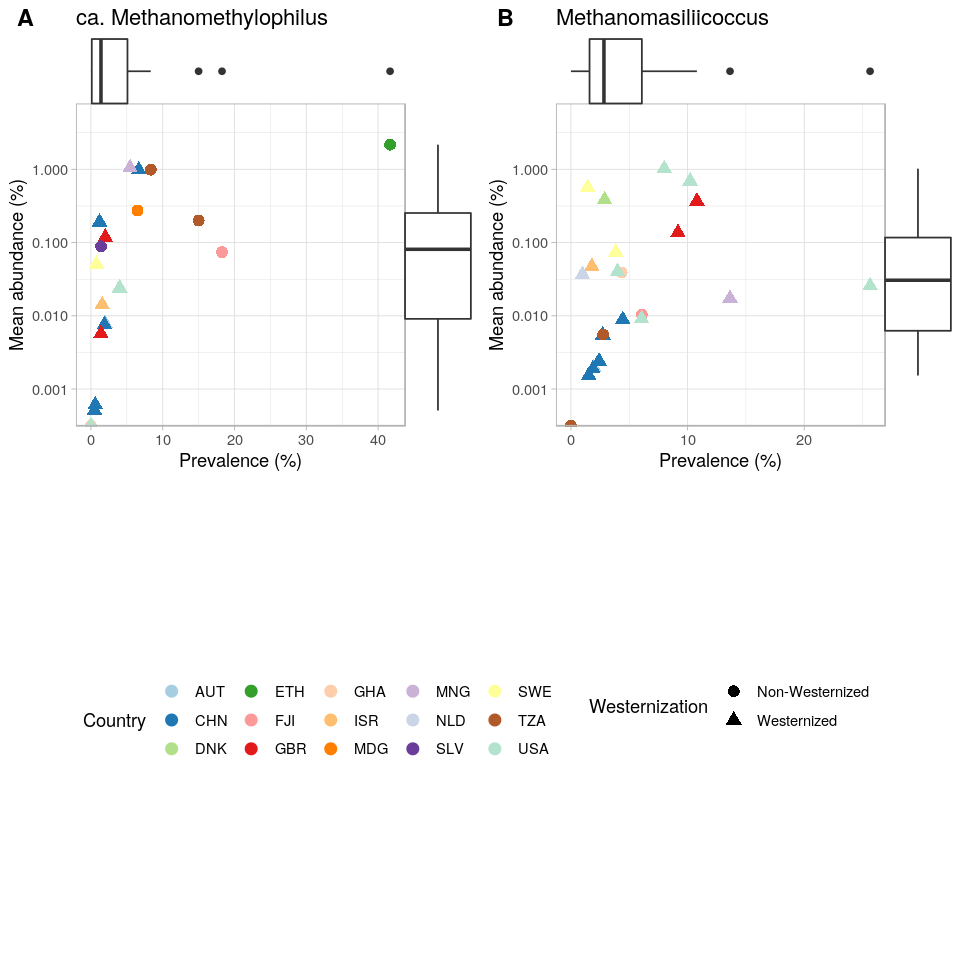

In [236]:
# Combine scatter plots
# http://www.lreding.com/nonstandard_deviations/2017/08/19/cowmarg/
Mmassilii_scatter = plot_grid(ca_Mmethyl_combined,
                  Mmasiliicoccus_combined,
                  align = 'vh',
                  labels = c("A", "B", "C"),
                  hjust = -1,
                  nrow = 1)

# Add legend
Mmassilii_combined_scatter = plot_grid(Mmassilii_scatter, country_legend, nrow = 2)

# Plot and save
options(repr.plot.width = 8, repr.plot.height = 8)

Mmassilii_combined_scatter

plot_file = file.path(plots_dir, "Mmassilii_GM_scatter.png")
save_plot(filename = plot_file, plot = Mmassilii_combined_scatter,
          base_height = 8, base_width = 8, dpi = 300)

# Westernization

## Prepare tables

In [237]:
# Create table for LMM
ca_Mmethyl_IDs = GM_tax %>% 
    filter(str_detect(Genus, "Methanomethylophilus")) %>%
    pull(taxonomy_id)

Mmasiliicoccus_IDs = GM_tax %>% 
    filter(str_detect(Genus, "Methanomassiliicoccus")) %>%
    pull(taxonomy_id)

Mmassilii_abundances = GM_bracken %>% 
    select(Sample, one_of(ca_Mmethyl_IDs, Mmasiliicoccus_IDs)) 
                      
GM_metadata_filt = GM_metadata %>%
    dplyr::select(Sample, dataset_name, age, gender, country, non_westernized)

Mmassilii_LMM_df = left_join(Mmassilii_abundances, GM_metadata_filt, by = "Sample")

Mmasiliicoccus_abund = Mmassilii_LMM_df %>%
    dplyr::select(Mmasiliicoccus_IDs) %>%
    rowSums

ca_Mmethyl_abund = Mmassilii_LMM_df %>%
    dplyr::select(ca_Mmethyl_IDs) %>%
    rowSums

Mmassilii_LMM_df = Mmassilii_LMM_df %>%
    mutate(ca_Mmethyl_abund, Mmasiliicoccus_abund) %>%
    dplyr::select(-starts_with("TID")) %>%
    mutate(ca_Mmethyl_pa = if_else(ca_Mmethyl_abund == 0, 0, 1), 
           Mmasiliicoccus_pa = if_else(Mmasiliicoccus_abund == 0, 0, 1) )

Mmassilii_LMM_df %>% dfhead

[1] 4472   10


Sample,dataset_name,age,gender,country,non_westernized,ca_Mmethyl_abund,Mmasiliicoccus_abund,ca_Mmethyl_pa,Mmasiliicoccus_pa
<chr>,<chr>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
A01_02_1FE,PasolliE_2018,NA,NA,MDG,yes,0.00046,0,1,0
A02_01_1FE,PasolliE_2018,NA,NA,MDG,yes,0.00000,0,0,0
A03_01_1FE,PasolliE_2018,NA,NA,MDG,yes,0.00000,0,0,0


In [241]:
Mmassilii_LMM_df %>%
    group_by(non_westernized) %>%
    summarise(Mean_Mmethyl_pa = mean(ca_Mmethyl_pa), 
              sd_Mmethyl_pa = sd(ca_Mmethyl_pa), 
              Mean_Mmasiliicoccus_pa = mean(Mmasiliicoccus_pa),
              sd_Mmasiliicoccus_pa = sd(Mmasiliicoccus_pa)) %>%
    mutate_if(is.numeric, )

non_westernized,Mean_Mmethyl_pa,sd_Mmethyl_pa,Mean_Mmasiliicoccus_pa,sd_Mmasiliicoccus_pa
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
no,0.01067616,0.1027855,0.04956787,0.2170780
yes,0.08921933,0.2853254,0.03903346,0.1938548


## GLMs Prevalence

In [242]:
# Westernization
# ca_Mmethyl
Mmethyl_Westernization_PA = glmer(ca_Mmethyl_pa ~ non_westernized + (1 | dataset_name) + (1 | country), 
                          data = Mmassilii_LMM_df, family = "binomial")

summary(Mmethyl_Westernization_PA)

# Mmassiliicoccus
Mmassiliicoccus_Westernization_PA = glmer(Mmasiliicoccus_pa ~ non_westernized + (1 | dataset_name) + (1 | country), data = Mmassilii_LMM_df, family = "binomial")
summary(Mmassiliicoccus_Westernization_PA)

boundary (singular) fit: see ?isSingular


Generalized linear mixed model fit by maximum likelihood (Laplace
  Approximation) [glmerMod]
 Family: binomial  ( logit )
Formula: ca_Mmethyl_pa ~ non_westernized + (1 | dataset_name) + (1 | country)
   Data: Mmassilii_LMM_df

     AIC      BIC   logLik deviance df.resid 
   767.7    793.3   -379.9    759.7     4468 

Scaled residuals: 
    Min      1Q  Median      3Q     Max 
-0.6936 -0.1211 -0.1169 -0.0794 12.6869 

Random effects:
 Groups       Name        Variance  Std.Dev. 
 dataset_name (Intercept) 1.032e+00 1.016e+00
 country      (Intercept) 2.152e-09 4.639e-05
Number of obs: 4472, groups:  dataset_name, 36; country, 30

Fixed effects:
                   Estimate Std. Error z value Pr(>|z|)    
(Intercept)         -4.7878     0.3091 -15.490  < 2e-16 ***
non_westernizedyes   1.7806     0.5067   3.514 0.000441 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Correlation of Fixed Effects:
            (Intr)
nn_wstrnzdy -0.431
convergence code: 0
boundary (s

Generalized linear mixed model fit by maximum likelihood (Laplace
  Approximation) [glmerMod]
 Family: binomial  ( logit )
Formula: Mmasiliicoccus_pa ~ non_westernized + (1 | dataset_name) + (1 |  
    country)
   Data: Mmassilii_LMM_df

     AIC      BIC   logLik deviance df.resid 
  1614.7   1640.4   -803.4   1606.7     4468 

Scaled residuals: 
    Min      1Q  Median      3Q     Max 
-0.4588 -0.3170 -0.1632 -0.1027  9.7406 

Random effects:
 Groups       Name        Variance Std.Dev.
 dataset_name (Intercept) 0.2599   0.5098  
 country      (Intercept) 1.2494   1.1178  
Number of obs: 4472, groups:  dataset_name, 36; country, 30

Fixed effects:
                   Estimate Std. Error z value Pr(>|z|)    
(Intercept)         -4.1734     0.4159 -10.034   <2e-16 ***
non_westernizedyes   0.4351     0.4742   0.918    0.359    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Correlation of Fixed Effects:
            (Intr)
nn_wstrnzdy -0.463

In [243]:
# age
# ca_Mmethyl
Mmethyl_age_PA = glmer(ca_Mmethyl_pa ~ age + (1 | dataset_name) + (1 | country), 
                          data = Mmassilii_LMM_df, family = "binomial")

summary(Mmethyl_age_PA)

# Mmassiliicoccus
Mmassiliicoccus_age_PA = glmer(Mmasiliicoccus_pa ~ age + (1 | dataset_name) + (1 | country), 
                               data = Mmassilii_LMM_df, family = "binomial")
summary(Mmassiliicoccus_age_PA)

Generalized linear mixed model fit by maximum likelihood (Laplace
  Approximation) [glmerMod]
 Family: binomial  ( logit )
Formula: ca_Mmethyl_pa ~ age + (1 | dataset_name) + (1 | country)
   Data: Mmassilii_LMM_df

     AIC      BIC   logLik deviance df.resid 
   403.9    426.4   -198.0    395.9     2034 

Scaled residuals: 
    Min      1Q  Median      3Q     Max 
-0.8114 -0.1383 -0.0710 -0.0444 12.2991 

Random effects:
 Groups       Name        Variance Std.Dev.
 country      (Intercept) 2.151    1.467   
 dataset_name (Intercept) 2.140    1.463   
Number of obs: 2038, groups:  country, 27; dataset_name, 22

Fixed effects:
             Estimate Std. Error z value Pr(>|z|)    
(Intercept) -4.576358   0.864807  -5.292 1.21e-07 ***
age         -0.002856   0.012725  -0.224    0.822    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Correlation of Fixed Effects:
    (Intr)
age -0.643

boundary (singular) fit: see ?isSingular


Generalized linear mixed model fit by maximum likelihood (Laplace
  Approximation) [glmerMod]
 Family: binomial  ( logit )
Formula: Mmasiliicoccus_pa ~ age + (1 | dataset_name) + (1 | country)
   Data: Mmassilii_LMM_df

     AIC      BIC   logLik deviance df.resid 
   632.9    655.4   -312.5    624.9     2034 

Scaled residuals: 
    Min      1Q  Median      3Q     Max 
-0.3668 -0.2175 -0.1482 -0.1030  9.8394 

Random effects:
 Groups       Name        Variance  Std.Dev. 
 country      (Intercept) 6.308e-09 7.942e-05
 dataset_name (Intercept) 1.083e+00 1.041e+00
Number of obs: 2038, groups:  country, 27; dataset_name, 22

Fixed effects:
            Estimate Std. Error z value Pr(>|z|)    
(Intercept) -4.20776    0.56989  -7.384 1.54e-13 ***
age          0.00880    0.01102   0.799    0.424    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Correlation of Fixed Effects:
    (Intr)
age -0.799
convergence code: 0
boundary (singular) fit: see ?isSingular


In [244]:
# gender
# ca_Mmethyl
Mmethyl_gender_PA = glmer(ca_Mmethyl_pa ~ gender + (1 | dataset_name) + (1 | country), 
                          data = Mmassilii_LMM_df, family = "binomial")

summary(Mmethyl_gender_PA)

# Mmassiliicoccus
Mmassiliicoccus_gender_PA = glmer(Mmasiliicoccus_pa ~ gender + (1 | dataset_name) + (1 | country), 
                                  data = Mmassilii_LMM_df, family = "binomial")
summary(Mmassiliicoccus_gender_PA)

Generalized linear mixed model fit by maximum likelihood (Laplace
  Approximation) [glmerMod]
 Family: binomial  ( logit )
Formula: ca_Mmethyl_pa ~ gender + (1 | dataset_name) + (1 | country)
   Data: Mmassilii_LMM_df

     AIC      BIC   logLik deviance df.resid 
   377.3    400.2   -184.7    369.3     2260 

Scaled residuals: 
    Min      1Q  Median      3Q     Max 
-0.4664 -0.1167 -0.0825 -0.0534 12.9723 

Random effects:
 Groups       Name        Variance Std.Dev.
 country      (Intercept) 1.302    1.141   
 dataset_name (Intercept) 1.270    1.127   
Number of obs: 2264, groups:  country, 25; dataset_name, 21

Fixed effects:
            Estimate Std. Error z value Pr(>|z|)    
(Intercept) -4.72326    0.55452  -8.518   <2e-16 ***
gendermale   0.07575    0.34494   0.220    0.826    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Correlation of Fixed Effects:
           (Intr)
gendermale -0.256

boundary (singular) fit: see ?isSingular


Generalized linear mixed model fit by maximum likelihood (Laplace
  Approximation) [glmerMod]
 Family: binomial  ( logit )
Formula: Mmasiliicoccus_pa ~ gender + (1 | dataset_name) + (1 | country)
   Data: Mmassilii_LMM_df

     AIC      BIC   logLik deviance df.resid 
   658.0    680.9   -325.0    650.0     2260 

Scaled residuals: 
    Min      1Q  Median      3Q     Max 
-0.3359 -0.2118 -0.1625 -0.1073  9.6905 

Random effects:
 Groups       Name        Variance Std.Dev.
 country      (Intercept) 0.000    0.000   
 dataset_name (Intercept) 1.045    1.022   
Number of obs: 2264, groups:  country, 25; dataset_name, 21

Fixed effects:
            Estimate Std. Error z value Pr(>|z|)    
(Intercept) -3.91656    0.38594 -10.148   <2e-16 ***
gendermale  -0.09546    0.29704  -0.321    0.748    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Correlation of Fixed Effects:
           (Intr)
gendermale -0.360
convergence code: 0
boundary (singular) fit: see ?isSingular


In [245]:
PA_pvals = list(Mmethyl_Westernization_PA, 
                Mmethyl_age_PA,
                Mmethyl_gender_PA,
                Mmassiliicoccus_Westernization_PA, 
                Mmassiliicoccus_age_PA, 
                Mmassiliicoccus_gender_PA)
PA_pvals %>%
    map_df(function(x) rownames_to_column(as.data.frame(summary(x)$coefficients))) %>%
    filter(rowname != "(Intercept)") %>%
    rename("Pval" = "Pr(>|z|)") %>%
    mutate(Padj = p.adjust(Pval))
    

rowname,Estimate,Std. Error,z value,Pval,Padj
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
non_westernizedyes,1.780623651,0.50668557,3.5142577,0.0004409849,0.002645909
age,-0.002856226,0.01272487,-0.2244601,0.8223992977,1.000000000
gendermale,0.075749740,0.34493807,0.2196039,0.8261796676,1.000000000
non_westernizedyes,0.435097783,0.47418571,0.9175683,0.3588449174,1.000000000
age,0.008800173,0.01101488,0.7989350,0.4243281213,1.000000000
gendermale,-0.095463798,0.29703623,-0.3213877,0.7479165884,1.000000000


## GLMs abundance

In [246]:
# Westernization
# ca_Mmethyl
Mmethyl_Westernization = lmer(log(ca_Mmethyl_abund + 1e-6) ~ non_westernized + 
                              (1 | dataset_name) + 
                              (1 | country), 
                          data = Mmassilii_LMM_df)
summary(Mmethyl_Westernization)

# Mmasiliicoccus
Mmasiliicoccus_Westernization = lmer(log(Mmasiliicoccus_abund + 1e-6) ~ non_westernized + 
                                     (1 | dataset_name) + 
                                     (1 | country), 
                                     data = Mmassilii_LMM_df)
summary(Mmasiliicoccus_Westernization)

Linear mixed model fit by REML. t-tests use Satterthwaite's method [
lmerModLmerTest]
Formula: 
log(ca_Mmethyl_abund + 1e-06) ~ non_westernized + (1 | dataset_name) +  
    (1 | country)
   Data: Mmassilii_LMM_df

REML criterion at convergence: 8389.6

Scaled residuals: 
    Min      1Q  Median      3Q     Max 
-3.7110 -0.1022 -0.0812 -0.0226 13.8246 

Random effects:
 Groups       Name        Variance  Std.Dev.
 dataset_name (Intercept) 0.0006061 0.02462 
 country      (Intercept) 0.2338418 0.48357 
 Residual                 0.3734929 0.61114 
Number of obs: 4472, groups:  dataset_name, 36; country, 30

Fixed effects:
                    Estimate Std. Error        df  t value Pr(>|t|)    
(Intercept)        -13.60836    0.10218  30.36984 -133.178   <2e-16 ***
non_westernizedyes  -0.09109    0.10320 382.15125   -0.883    0.378    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Correlation of Fixed Effects:
            (Intr)
nn_wstrnzdy -0.331

Linear mixed model fit by REML. t-tests use Satterthwaite's method [
lmerModLmerTest]
Formula: 
log(Mmasiliicoccus_abund + 1e-06) ~ non_westernized + (1 | dataset_name) +  
    (1 | country)
   Data: Mmassilii_LMM_df

REML criterion at convergence: 11173.5

Scaled residuals: 
    Min      1Q  Median      3Q     Max 
-0.4511 -0.3701 -0.1033 -0.0663 10.2278 

Random effects:
 Groups       Name        Variance Std.Dev.
 dataset_name (Intercept) 0.002683 0.0518  
 country      (Intercept) 0.012847 0.1133  
 Residual                 0.706132 0.8403  
Number of obs: 4472, groups:  dataset_name, 36; country, 30

Fixed effects:
                     Estimate Std. Error         df t value Pr(>|t|)    
(Intercept)        -13.691970   0.038059  19.726704 -359.75   <2e-16 ***
non_westernizedyes  -0.002673   0.066162  38.874438   -0.04    0.968    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Correlation of Fixed Effects:
            (Intr)
nn_wstrnzdy -0.526

In [247]:
# age
# ca_Mmethyl
Mmethyl_age = lmer(log(ca_Mmethyl_abund + 1e-6) ~ age + (1 | dataset_name) + (1 | country), 
                          data = Mmassilii_LMM_df)
summary(Mmethyl_age)

# Mmasiliicoccus
Mmasiliicoccus_age = lmer(log(Mmasiliicoccus_abund + 1e-6) ~ age + (1 | dataset_name) + (1 | country), 
                          data = Mmassilii_LMM_df)
summary(Mmasiliicoccus_age)

Linear mixed model fit by REML. t-tests use Satterthwaite's method [
lmerModLmerTest]
Formula: log(ca_Mmethyl_abund + 1e-06) ~ age + (1 | dataset_name) + (1 |  
    country)
   Data: Mmassilii_LMM_df

REML criterion at convergence: 4566.7

Scaled residuals: 
    Min      1Q  Median      3Q     Max 
-3.2090 -0.1154 -0.0385 -0.0091 11.1766 

Random effects:
 Groups       Name        Variance Std.Dev.
 country      (Intercept) 0.24387  0.4938  
 dataset_name (Intercept) 0.01089  0.1044  
 Residual                 0.52776  0.7265  
Number of obs: 2038, groups:  country, 27; dataset_name, 22

Fixed effects:
              Estimate Std. Error         df  t value Pr(>|t|)    
(Intercept) -1.358e+01  1.262e-01  4.133e+01 -107.590   <2e-16 ***
age         -8.161e-04  1.404e-03  9.973e+01   -0.581    0.562    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Correlation of Fixed Effects:
    (Intr)
age -0.481

boundary (singular) fit: see ?isSingular


Linear mixed model fit by REML. t-tests use Satterthwaite's method [
lmerModLmerTest]
Formula: log(Mmasiliicoccus_abund + 1e-06) ~ age + (1 | dataset_name) +  
    (1 | country)
   Data: Mmassilii_LMM_df

REML criterion at convergence: 5253.2

Scaled residuals: 
    Min      1Q  Median      3Q     Max 
-0.8589 -0.2236 -0.1057 -0.0493  9.4076 

Random effects:
 Groups       Name        Variance Std.Dev.
 country      (Intercept) 0.05415  0.2327  
 dataset_name (Intercept) 0.00000  0.0000  
 Residual                 0.75300  0.8678  
Number of obs: 2038, groups:  country, 27; dataset_name, 22

Fixed effects:
              Estimate Std. Error         df  t value Pr(>|t|)    
(Intercept) -13.702090   0.085127  26.794763 -160.961   <2e-16 ***
age           0.001632   0.001399 770.791376    1.166    0.244    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Correlation of Fixed Effects:
    (Intr)
age -0.716
convergence code: 0
boundary (singular) fit: see ?isSingular


In [248]:
# gender
# ca_Mmethyl
Mmethyl_gender = lmer(log(ca_Mmethyl_abund + 1e-6) ~ gender + (1 | dataset_name) + (1 | country), 
                          data = Mmassilii_LMM_df)
summary(Mmethyl_gender)

# Mmasiliicoccus
Mmasiliicoccus_gender = lmer(log(Mmasiliicoccus_abund + 1e-6) ~ gender + (1 | dataset_name) + (1 | country), 
                          data = Mmassilii_LMM_df)
summary(Mmasiliicoccus_gender)

Linear mixed model fit by REML. t-tests use Satterthwaite's method [
lmerModLmerTest]
Formula: log(ca_Mmethyl_abund + 1e-06) ~ gender + (1 | dataset_name) +  
    (1 | country)
   Data: Mmassilii_LMM_df

REML criterion at convergence: 4060.1

Scaled residuals: 
    Min      1Q  Median      3Q     Max 
-0.9766 -0.1383 -0.0399 -0.0084 13.7916 

Random effects:
 Groups       Name        Variance Std.Dev.
 country      (Intercept) 0.01531  0.1237  
 dataset_name (Intercept) 0.01420  0.1192  
 Residual                 0.34426  0.5867  
Number of obs: 2264, groups:  country, 25; dataset_name, 21

Fixed effects:
              Estimate Std. Error         df  t value Pr(>|t|)    
(Intercept)  -13.70144    0.04599   18.85235 -297.925   <2e-16 ***
gendermale     0.00189    0.02758 2244.01184    0.069    0.945    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Correlation of Fixed Effects:
           (Intr)
gendermale -0.246

Warning message in checkConv(attr(opt, "derivs"), opt$par, ctrl = control$checkConv, :
“Model failed to converge with max|grad| = 0.00638001 (tol = 0.002, component 1)”

Linear mixed model fit by REML. t-tests use Satterthwaite's method [
lmerModLmerTest]
Formula: log(Mmasiliicoccus_abund + 1e-06) ~ gender + (1 | dataset_name) +  
    (1 | country)
   Data: Mmassilii_LMM_df

REML criterion at convergence: 5594

Scaled residuals: 
    Min      1Q  Median      3Q     Max 
-0.4901 -0.2011 -0.1003 -0.0702 10.3708 

Random effects:
 Groups       Name        Variance  Std.Dev.
 country      (Intercept) 7.651e-06 0.002766
 dataset_name (Intercept) 1.618e-02 0.127196
 Residual                 6.838e-01 0.826915
Number of obs: 2264, groups:  country, 25; dataset_name, 21

Fixed effects:
              Estimate Std. Error         df  t value Pr(>|t|)    
(Intercept)  -13.67603    0.03995   25.52530 -342.357   <2e-16 ***
gendermale    -0.03972    0.03824 1840.81345   -1.039    0.299    
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Correlation of Fixed Effects:
           (Intr)
gendermale -0.409
convergence code: 0
Model failed to converge w

# Co-occurrence per country

## Functions

In [61]:
# Function to create presence/absence tables
abund_pa = function(physeq_object, presence = FALSE, threshold = 1e-6){

    if(presence == TRUE){
        # create presence/absence phyloseq table
        physeq_glom_pa = physeq_object %>%
            filter_taxa(., function(x) mean(x) > threshold, TRUE) %>%
            transform_sample_counts(., function(x) ifelse(x > 0, yes = 1, no = 0)) 
        
        glom_pa = physeq_glom_pa %>% 
            otu_table %>% 
            extract_phyloseq
                                    
        # Add species name to pres/abs table
        # Coocurr crashes when using numbers as species names
        tax_glom = physeq_glom_pa %>% 
            tax_table() %>% 
            extract_phyloseq
    
        rownames(glom_pa) = tax_glom$ta6
        glom_pa

        
    } else {
                    # create presence/absence phyloseq table
        physeq_glom_rel = physeq_object %>%
            filter_taxa(., function(x) mean(x) > threshold, TRUE)
        
        glom_rel = physeq_glom_rel %>% 
            otu_table %>% 
            extract_phyloseq
                                    
        # Add species name to pres/abs table
        # Coocurr crashes when using numbers as species names
        tax_glom = physeq_glom_rel %>% 
            tax_table() %>% 
            extract_phyloseq
    
        rownames(glom_rel) = tax_glom$ta6
        glom_rel

    }
}

In [62]:
# Function to extract dataset/country combinations with Mmassilii 
# prevalence > 5% as above
meta_filter = function(phyloseq_object){
    meta_data = phyloseq_object %>%
        sample_data() %>%
        extract_phyloseq
    dataset_name = meta_data[1,1]
    
    country = meta_data[1,2]
    data.frame(dataset_name, country)
}

In [63]:
# Create function to obtain presence/absence table and execute cooccur
co_occurrence = function(physeq_object, eff_matrix = FALSE){
    # Create presence/absence table
    pa_table = abund_pa(physeq_object, presence = TRUE)
    
    # Execute the coocurr function
    cooccur_genus = cooccur(pa_table, 
                            type = "spp_site",
                            thresh = T,
                            spp_names = T)
    # Extract effect sizes                            
    cooccur_effects = effect.sizes(cooccur_genus, 
                                   matrix = eff_matrix, 
                                   standardized = T)
    list(cooccur_genus, cooccur_effects)
}

In [64]:
# Proportionality on phyloseq object
rho_propr = function(physeq_object){
    
    # Filter low abundance taxa and impute zeros
    filt_physeq = physeq_object %>%
        filter_taxa(., function(x) mean(x) > 5e-6, TRUE)
                    
    Otu_nZero = filt_physeq %>%
        otu_table %>% 
        extract_phyloseq %>%
        t() %>%
        cmultRepl(., method = "SQ")
                    
    # Add tax names
    tax_nZero = filt_physeq %>%
        tax_table %>% 
        extract_phyloseq %>% 
        pull(ta6)
                    
    colnames(Otu_nZero) = tax_nZero  
    
    # Calculate rho                
    Otu_genus_propr = Otu_nZero %>%
        propr(., metric = "rho", p = 100) 
                    
    #Obtain rho table                
    rho_df = Otu_genus_propr@matrix %>%
        as.data.frame() %>%
        rownames_to_column("Tax") %>%
        dplyr::select(Tax, one_of("Methanomassiliicoccus", "Candidatus Methanomethylophilus"))
    
    rho_df

}
                    
# safely version of function
safely_rho_propr = safely(rho_propr)

In [65]:
# Create function to obtain co-occurrence tables for Mmassilii genera
extract_cooccur = function(co_occurr){
    # Extract effect size from co_occurrence result
    # Convert to df
    effects_df = co_occurr[[2]] %>%
        as.matrix %>%
        data.frame
    
    # Extract co-occur effect sizes of Methanomassiliicoccus and ca Methanomethylophilus
    # Removes NAs and taxa with 0 in both genera
    df_Mmassilii = effects_df %>%
        rownames_to_column("Tax") %>%
        dplyr::select(Tax, one_of("Methanomassiliicoccus", "Candidatus.Methanomethylophilus")) %>%
        gather(Mmassilii, Effect, -Tax) %>%
        drop_na() %>%
        filter(Effect != 0)
        #filter_at(vars(matches("Methano")),  all_vars(. != 0))
    
    df_Mmassilii

}

safely_extract_cooccur = safely(extract_cooccur, otherwise = NA)

In [66]:
# Create function to obtain co-occurrence significant taxa co-occur
significant_cooccur = function(co_occurr){
    # Extract p-values
    sig_df = cooccur_large[[1]]$results
    
    # Extract effect size from co_occurrence result
    # Convert to df
    effects_df = co_occurr[[2]] %>%
        as.matrix %>%
        data.frame 
    # Separate tables for Mmassiliicoccus and ca Methanomethyl
    # If not present in dataset, out table is NA
    if("Candidatus.Methanomethylophilus" %in% colnames(effects_df)){
        # Pull significant taxa
        ca_Mmethyl_sig_coocur = sig_df %>%
            filter(sp1_name == "Candidatus Methanomethylophilus" | sp2_name == "Candidatus Methanomethylophilus", 
                   p_gt < 0.05) %>%
            mutate(sp2_name = if_else(sp2_name  == "Candidatus Methanomethylophilus", sp1_name, sp2_name), 
                   sp2_name = as.character(sp2_name)) %>%
            pull(sp2_name)
        
    
        # filter effects df to retain significant taxa
        ca_Mmethyl_coocur = effects_df %>%
            rownames_to_column("Tax") %>%
            select(Tax, "Candidatus.Methanomethylophilus") %>%
            gather(Mmassilii, Effect, -Tax) %>%
            drop_na() %>%
            filter(Tax %in% ca_Mmethyl_sig_coocur & Effect > 0.001) %>%
            mutate(Mmassilii = str_replace(Mmassilii,
                                           "Candidatus.Methanomethylophilus",
                                           "Candidatus Methanomethylophilus"))
     }else{
        
        ca_Mmethyl_coocur = data.frame(Tax = NA, Mmassilii = "Candidatus Methanomethylophilus", Effect = NA)
        
    }
    
    #Methanomassiliicoccus
    if("Methanomassiliicoccus" %in% colnames(effects_df)){
        #Mmassiliicoccus
        # Pull significant taxa
        Mmassiliicoccus_sig_coocur = sig_df %>%
            filter(sp1_name == "Methanomassiliicoccus" | sp2_name == "Methanomassiliicoccus", 
                   p_gt < 0.05) %>%
            mutate(sp2_name = if_else(sp2_name  == "Methanomassiliicoccus", sp1_name, sp2_name), 
                   sp2_name = as.character(sp2_name)) %>%
            pull(sp2_name)
        
    
        # filter effects df to retain significant taxa
        Mmassiliicoccus_coocur = effects_df %>%
            rownames_to_column("Tax") %>%
            select(Tax, "Methanomassiliicoccus") %>%
            gather(Mmassilii, Effect, -Tax) %>%
            drop_na()# %>%
            #filter(Tax %in% Mmassiliicoccus_sig_coocur & Effect > 0.001) 
    
    }else{
        
        Mmassiliicoccus_coocur = data.frame(Tax = NA, Mmassilii = "Methanomassiliicoccus", Effect = NA)
        
    }

#     list(ca_Mmethyl_coocur = ca_Mmethyl_coocur, Mmassiliicoccus_coocur = Mmassiliicoccus_coocur)
    bind_rows(ca_Mmethyl_coocur, Mmassiliicoccus_coocur)
}

safely_significant_cooccur = safely(significant_cooccur, otherwise = NA)

## Create list of phyloseq objects

In [67]:
# Filter studies with prevalence of ca_Mmethyl or Mmassiliicoccus > 5%
Mmasilii_studies = GM_combined_summary %>% 
    filter(ca_Mmethyl_Prevalence >= 5 | Mmasiliicoccus_Prevalence >= 5) 

In [68]:
Mmasilii_studies

dataset_name,country,ca_Mmethyl_Prevalence,ca_Mmethyl_mean,Mmasiliicoccus_Prevalence,Mmasiliicoccus_mean
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
YeZ_2018,CHN,6.666667,9.844444e-03,4.444444,8.888889e-05
TettAJ_2019_c,ETH,41.666667,2.170833e-02,0.000000,0.000000e+00
BritoIL_2016,FJI,18.260870,7.391304e-04,6.086957,1.043478e-04
Visconti_2019,GBR,1.395813,5.682951e-05,9.172483,1.363908e-03
XieH_2016,GBR,2.000000,1.180000e-03,10.800000,3.668000e-03
PasolliE_2018,MDG,6.481481,2.740741e-03,0.000000,0.000000e+00
LiuW_2016,MNG,5.454545,1.046364e-02,13.636364,1.727273e-04
RampelliS_2015,TZA,15.000000,2.000000e-03,0.000000,0.000000e+00
TettAJ_2019_a,TZA,8.333333,9.888889e-03,2.777778,5.555556e-05


In [69]:
# Filter datasets
filt_df_list = phyloseq_list %>% 
    keep(function(x){
            meta_filter(x)$dataset_name %in% Mmasilii_studies$dataset_name &
            meta_filter(x)$country %in% Mmasilii_studies$country
                    }) 

## Co-occurrence on retained studies

In [ ]:
cooccur_list = future_map(filt_df_list, co_occurrence)

In [75]:
cooccur_list %>% str

List of 13
 $ :List of 2
  ..$ :List of 16
  .. ..$ call                : language cooccur(mat = pa_table, type = "spp_site", thresh = T, spp_names = T)
  .. ..$ results             :'data.frame':	207334 obs. of  11 variables:
  .. .. ..$ sp1         : num [1:207334] 1 1 1 1 1 1 1 1 1 1 ...
  .. .. ..$ sp2         : num [1:207334] 7 20 24 26 29 31 34 39 40 47 ...
  .. .. ..$ sp1_inc     : num [1:207334] 4 4 4 4 4 4 4 4 4 4 ...
  .. .. ..$ sp2_inc     : num [1:207334] 17 27 43 22 20 31 12 16 26 15 ...
  .. .. ..$ obs_cooccur : num [1:207334] 2 3 4 3 1 4 3 4 4 3 ...
  .. .. ..$ prob_cooccur: num [1:207334] 0.034 0.053 0.085 0.043 0.04 0.061 0.024 0.032 0.051 0.03 ...
  .. .. ..$ exp_cooccur : num [1:207334] 1.5 2.4 3.8 2 1.8 2.8 1.1 1.4 2.3 1.3 ...
  .. .. ..$ p_lt        : num [1:207334] 0.856 0.882 1 0.951 0.394 ...
  .. .. ..$ p_gt        : num [1:207334] 0.489 0.471 0.828 0.287 0.915 ...
  .. .. ..$ sp1_name    : Factor w/ 789 levels "Absiella","Acetanaerobacterium",..: 349 349 349 3

In [189]:
study_1 = cooccur_list[[1]]
study_1_1 = study_1[1]
study_1_2 = study_1[2]



In [190]:
study_1_1 %>% str
study_1_2 %>% str

List of 1
 $ :List of 16
  ..$ call                : language cooccur(mat = pa_table, type = "spp_site", thresh = T, spp_names = T)
  ..$ results             :'data.frame':	207334 obs. of  11 variables:
  .. ..$ sp1         : num [1:207334] 1 1 1 1 1 1 1 1 1 1 ...
  .. ..$ sp2         : num [1:207334] 7 20 24 26 29 31 34 39 40 47 ...
  .. ..$ sp1_inc     : num [1:207334] 4 4 4 4 4 4 4 4 4 4 ...
  .. ..$ sp2_inc     : num [1:207334] 17 27 43 22 20 31 12 16 26 15 ...
  .. ..$ obs_cooccur : num [1:207334] 2 3 4 3 1 4 3 4 4 3 ...
  .. ..$ prob_cooccur: num [1:207334] 0.034 0.053 0.085 0.043 0.04 0.061 0.024 0.032 0.051 0.03 ...
  .. ..$ exp_cooccur : num [1:207334] 1.5 2.4 3.8 2 1.8 2.8 1.1 1.4 2.3 1.3 ...
  .. ..$ p_lt        : num [1:207334] 0.856 0.882 1 0.951 0.394 ...
  .. ..$ p_gt        : num [1:207334] 0.489 0.471 0.828 0.287 0.915 ...
  .. ..$ sp1_name    : Factor w/ 789 levels "Absiella","Acetanaerobacterium",..: 349 349 349 349 349 349 349 349 349 349 ...
  .. ..$ sp2_name    : 

In [206]:
# Create function to obtain co-occurrence tables for Mmassilii genera
extract_cooccur = function(co_occurr){
    # Extract effect size from co_occurrence result
    # Convert to df
    effects_df = co_occurr[1] 
    
    effects_df %>% dfhead
    
#     # Extract co-occur effect sizes of Methanomassiliicoccus and ca Methanomethylophilus
#     # Removes NAs and taxa with 0 in both genera
#     df_Mmassilii = effects_df %>%
#         filter_(str_detect(sp1, "Methanomethylophilus") | 
#            str_detect(sp2, "Methanomethylophilus") | 
#            str_detect(sp1, "Methanomassiliicoccus") | 
#            str_detect(sp2, "Methanomassiliicoccus")) %>%
#     drop_na() %>%
#     filter(effects != 0)
    
#     df_Mmassilii

}
safely_extract_cooccur = safely(extract_cooccur, otherwise = NA)

In [207]:
extract_cooccur(study_1)

NULL


[[1]]
Call:
cooccur(mat = pa_table, type = "spp_site", thresh = T, spp_names = T)

Of 310866 species pair combinations, 103532 pairs (33.3 %) were removed from the analysis because expected co-occurrence was < 1 and 207334 pairs were analyzed

Cooccurrence Table:
       sp1 sp2 sp1_inc sp2_inc obs_cooccur prob_cooccur exp_cooccur    p_lt
8        1  39       4      16           4        0.032         1.4 1.00000
12       1  53       4      19           4        0.038         1.7 1.00000
28       1  92       4      13           4        0.026         1.2 1.00000
59       1 127       4      22           4        0.043         2.0 1.00000
64       1 138       4      15           4        0.030         1.3 1.00000
68       1 144       4      18           4        0.036         1.6 1.00000
69       1 146       4      16           4        0.032         1.4 1.00000
75       1 159       4      14           4        0.028         1.2 1.00000
77       1 163       4      17           4        0.

In [203]:
map(study_1[2], function(x) extract_cooccur(x))

[[1]]
    [1] Halobiforma                     Actinomyces                    
    [3] Bifidobacterium                 Corynebacterium                
    [5] Mycobacterium                   Nocardia                       
    [7] Frankia                         Brevibacterium                 
    [9] Cellulomonas                    Curtobacterium                 
   [11] Microbacterium                  Arthrobacter                   
   [13] Rothia                          Actinoplanes                   
   [15] Micromonospora                  Amycolatopsis                  
   [17] Streptomyces                    Atopobium                      
   [19] Olsenella                       Collinsella                    
   [21] Enorma                          Senegalimassilia               
   [23] Adlercreutzia                   Arabia                         
   [25] Eggerthella                     Gordonibacter                  
   [27] Slackia                         Thermosulfidibacter            
   [29] Candidatus Symbiothrix          Bacteroides                    
   [31] Mediterranea                    Barnesiella                    
   [33] Coprobacter                     Dysgonomonas                   
   [35] Proteiniphilum                  Candidatus Homeothermus        
   [37] Muribaculum                     Butyricimonas                  
   [39] Culturomica                     Odoribacter                    
   [41] Paludibacter                    Gabonia                        
   [43] Gabonibacter                    Macellibacteroides             
   [45] Massilibacteroides              Porphyromonas                  
   [47] Sanguibacteroides               Alloprevotella                 
   [49] Paraprevotella                  Prevotella                     
   [51] Prevotellamassilia              Alistipes                      
   [53] Millionella                     Mucinivorans                   
   [55] Rikenella                       Tidjanibacter                  
   [57] Parabacteroides                 Tannerella                     
   [59] Labilibaculum                   Alkaliflexus                   
   [61] Labilibacter                    Thermophagus                   
   [63] Draconibacterium                Prolixibacter                  
   [65] Sunxiuqinia                     Chitinophaga                   
   [67] Cnuella                         Flavihumibacter                
   [69] Hydrobacter                     Niastella                      
   [71] Chryseolinea                    Algoriphagus                   
   [73] Belliella                       Echinicola                     
   [75] Nitritalea                      Dyadobacter                    
   [77] Emticicia                       Flectobacillus                 
   [79] Spirosoma                       Flammeovirga                   
   [81] Hymenobacter                    Pontibacter                    
   [83] Rufibacter                      Persicobacter                  
   [85] Thermonema                      Algibacter                     
   [87] Aquimarina                      Arenibacter                    
   [89] Capnocytophaga                  Cellulophaga                   
   [91] Chryseobacterium                Cruoricaptor                   
   [93] Elizabethkingia                 Flagellimonas                  
   [95] Flavobacterium                  Gramella                       
   [97] Kriegella                       Leeuwenhoekiella               
   [99] Lutibacter                      Maribacter                     
  [101] Muricauda                       Myroides                       
  [103] Polaribacter                    Psychroflexus                  
  [105] Salegentibacter                 Tenacibaculum                  
  [107] Zobellia                        Lewinella                      
  [109] Mucilaginibacter                Parapedobacter                 
  [111] Pedobacter                

```
# Create function to obtain co-occurrence tables for Mmassilii genera
extract_cooccur = function(co_occurr){
    # Extract effect size from co_occurrence result
    # Convert to df
    effects_df = co_occurr[[2]] %>%
        as.matrix %>%
        data.frame
    
    # Extract co-occur effect sizes of Methanomassiliicoccus and ca Methanomethylophilus
    # Removes NAs and taxa with 0 in both genera
    df_Mmassilii = effects_df %>%
        rownames_to_column("Tax") %>%
        dplyr::select(Tax, one_of("Methanomassiliicoccus", "Candidatus.Methanomethylophilus")) %>%
        gather(Mmassilii, Effect, -Tax) %>%
        drop_na() %>%
        filter(Effect != 0)
        #filter_at(vars(matches("Methano")),  all_vars(. != 0))
    
    df_Mmassilii

}
```

## Extract Mmassilii co-occurrence data

In [81]:
# # Extract cooccurrence on each study, create df of Methanomassilii
# Mmassilii_cooccur = map(cooccur_list, safely_extract_cooccur) %>%
#     map(function(x) x$result)
        
# names(Mmassilii_cooccur) = filt_df_list %>% 
#     future_map_dfr(meta_filter) %>%
#     mutate(label = str_c(dataset_name, country, sep = "__")) %>%
#     pull(label)

# Mmassilii_cooccur = Mmassilii_cooccur %>%
#         discard(function(x) is.null(dim(x)))
 
# # Create a single df with the effect size and study information
# Mmassilii_cooccur = map2(Mmassilii_cooccur, names(Mmassilii_cooccur), function(x, y) mutate(x, study = y)) %>%
#      bind_rows %>%
#      rename("cooccurr_effect" = "Effect")
                         
# Mmassilii_cooccur %>% dfhead

In [77]:
# Extract effect size of significant cooccurrences
cooccur_per_dataset = map(cooccur_list, function(x) safely_significant_cooccur(x)$result)
   
# Rename objects in list
names(cooccur_per_dataset) = filt_df_list %>% 
    future_map_dfr(meta_filter) %>%
    mutate(label = str_c(dataset_name, country, sep = "__")) %>%
    pull(label)

# Remove empty datasets
cooccur_per_dataset = cooccur_per_dataset %>%
        discard(function(x) nrow(x) == 2)
                
 
# Create a single df with the effect size and study information
cooccur_per_dataset = map2(cooccur_per_dataset, names(cooccur_per_dataset), 
                           function(x, y) mutate(x, study = y)) %>%
                      bind_rows %>%
                      rename("cooccurr_effect" = "Effect")
                         
cooccur_per_dataset %>% head

[[1]]
[1] NA

[[2]]
[1] NA

[[3]]
[1] NA

[[4]]
[1] NA

[[5]]
[1] NA

[[6]]
[1] NA

[[7]]
[1] NA

[[8]]
[1] NA

[[9]]
[1] NA

[[10]]
[1] NA

[[11]]
[1] NA

[[12]]
[1] NA

[[13]]
[1] NA

## Proportionality

In [ ]:
# Obtain rho on each dataset
Mmassilii_rho_raw = map(filt_df_list, safely_rho_propr) %>%
    map(function(x) x$result)

# Add names of datasets to list
names(Mmassilii_rho_raw) = filt_df_list %>% 
    future_map_dfr(meta_filter) %>%
    mutate(label = str_c(dataset_name, country, sep = "__")) %>%
    pull(label)

# Discards datasets with empty  results
Mmassilii_rho_discard = Mmassilii_rho_raw %>%
        discard(function(x) (is.null(dim(x)) | ncol(x) < 2))
             
# Create a single data frame with all studies data
Mmassilii_rho = map2(Mmassilii_rho_discard, names(Mmassilii_rho_discard), 
                     function(x, y) mutate(x, study = y)) %>%
    bind_rows(.) %>%
    gather(Mmassilii, rho, -Tax, -study ) 


## Combine rho and cooccur

In [ ]:
# Lists of taxa of interest
# TMA producers or correlated with circulating TMA
# List of TMA producers from 
# Rath et al. 2017 - 10.1186/s40168-017-0271-9
# Rath et al. 2019 - 10.3389/fmicb.2019.02966
# Fennema et al. 2016 - 10.1124/dmd.116.070615
# Fu et al. 2020 - 10.1093/ajcn/nqaa015.

# Also see
# 10.1099/jmm.0.053587-0
# 10.1186/s40168-018-0461-0

TMA_producers = c("Micrococcus", "Mobiluncus", "Bacillus", "Clostridium", 
                  "Staphylococcus", "Sarcina", "Streptococcus", "Alcaligenes",
                  "Campylobacter", "Citrobacter", "Escherichia", "Proteus", 
                  "Pseudomonas", "Olsenella", "Bacteroides", "Anaerococcus",
                  "Desulfitobacterium", "Enterococcus", "Desulfovibrio", 
                  "Edwardsiella", "Enterobacter", "Klebsiella", "Providencia",
                  "Yokenella", "Eubacterium", "Sporomusa", "Acinetobacter",
                  "Klebsiella", "Mitsuokella", "Megasphaera", "Helicobacter")
# Mmassilii
Mmassilii_genera = c('Candidatus Methanomethylophilus', 'Methanomassiliicoccus')

# Other Archaea
Archaea = physeq_large %>%
    tax_table %>%
    extract_phyloseq %>%
    filter(ta1 == "Archaea" & !(ta6 %in% Mmassilii_genera)) %>%
    mutate_all(as.character) %>%
    pull(ta6)

In [ ]:
TMA_associations_datasets = full_join(Mmassilii_rho, cooccur_per_dataset) %>%
    filter(rho > 0.1) %>% 
    group_by(Mmassilii) %>%
    count(Tax) %>%
    ungroup() %>%
    filter(Tax %in% TMA_producers) %>%
    arrange(Mmassilii,-n)


TMA_associations_datasets %>% 
    filter(Mmassilii == "Candidatus Methanomethylophilus") %>%
    mutate(prop = 100*(n/13)) %>%
    select(-Mmassilii)

TMA_associations_datasets %>% 
    filter(Mmassilii == "Methanomassiliicoccus") %>%
    mutate(prop = 100*(n/13)) %>%
    select(-Mmassilii)
  

In [ ]:
Archaea_associations_datasets = full_join(Mmassilii_rho, cooccur_per_dataset) %>%
    filter(rho > 0.1) %>% 
    group_by(Mmassilii) %>%
    count(Tax) %>%
    ungroup() %>%
    filter(Tax %in% Archaea) %>%
    arrange(Mmassilii,-n)

Archaea_associations_datasets

In [ ]:
Mmassilii_associations_datasets = full_join(Mmassilii_rho, cooccur_per_dataset) %>%
    filter(rho > 0.1) %>% 
    group_by(Mmassilii) %>%
    count(Tax) %>%
    ungroup() %>%
    filter(Tax %in% Mmassilii_genera) %>%
    arrange(Mmassilii,-n)

Mmassilii_associations_datasets

In [ ]:
send_email("Coocurr_per_dataset")

# Co-occurrence complete dataset

## Prepare single table

In [83]:
large_meta = GM_metadata %>% 
    select(Sample, dataset_name, country) %>%
    filter(country %in% retained_countries$country,
           dataset_name %in% retained_countries$dataset_name)


large_meta %>% dfhead

[1] 4446    3


Sample,dataset_name,country
<chr>,<chr>,<chr>
TRAVELRES1,Bengtsson-PalmeJ_2015,SWE
TRAVELRES10,Bengtsson-PalmeJ_2015,SWE
TRAVELRES11,Bengtsson-PalmeJ_2015,SWE


In [84]:
large_meta$dataset_name %>% unique %>% length
large_meta$country %>% unique %>% length
retained_countries %>% nrow

[1] 34

[1] 22

[1] 35

In [85]:
# Create phyloseq object
large_otu = GM_bracken %>%
    filter(Sample %in% large_meta$Sample)

large_otu %>% dim
large_otu[1:10, 1:10]

[1]  4446 18453

Sample,TID100053,TID1000568,TID1000569,TID1001240,TID100134,TID100174,TID100176,TID1001886,TID1002
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
A01_02_1FE,0,0,0,0,1e-05,0e+00,2e-05,0,0
A02_01_1FE,0,0,0,0,0e+00,0e+00,0e+00,0,0
A03_01_1FE,0,0,0,0,0e+00,0e+00,0e+00,0,0
A04_01_1FE,0,0,0,0,1e-05,1e-05,0e+00,0,0
A04_04_1FE,0,0,0,0,2e-05,0e+00,1e-05,0,0
A05_01_1FE,0,0,0,0,0e+00,0e+00,0e+00,0,0
A06_01_1FE,0,0,0,0,0e+00,0e+00,0e+00,0,0
A07_01_1FE,0,0,0,0,3e-05,1e-05,4e-05,0,0
A08_01_1FE,0,0,0,0,2e-05,0e+00,6e-05,0,0


In [86]:
# Convert complete table to phyloseq object
# Prepate OTU table
physeq_otu = large_otu %>% 
    #select(-dataset_name, -country) %>% 
    gather(TID, Abundance, -Sample) %>% 
    spread(Sample, Abundance) %>% 
    arrange(TID) %>% 
    select(-TID)

# Prepare taxonomy table
physeq_tax = GM_tax %>% 
    arrange(taxonomy_id) %>% 
    column_to_rownames("taxonomy_id")

# Prepare metadata table
physeq_meta = large_meta %>% 
    select(Sample, dataset_name, country)

# Fix row names
rownames(physeq_meta) = c()
physeq_meta = column_to_rownames(physeq_meta, "Sample")

# Create phyloseq object
OTU = otu_table(physeq_otu, taxa_are_rows = T)
TAX = tax_table(physeq_tax)
META = sample_data(physeq_meta)
physeq_relabund = phyloseq(OTU, TAX, META)

# Filter low abundance species
physeq_large = tax_glom(physeq = physeq_relabund, taxrank = "ta6") %>% 
    filter_taxa(., function(x) sum(x > 0) != 0, TRUE) %>%
    filter_taxa(., function(x) mean(x) > 5e-6, TRUE)
                
# Print
physeq_large

Warning message in .local(object):
“Coercing from data.frame class to character matrix 
prior to building taxonomyTable. 
This could introduce artifacts. 
Check your taxonomyTable, or coerce to matrix manually.”

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 384 taxa and 4446 samples ]
sample_data() Sample Data:       [ 4446 samples by 2 sample variables ]
tax_table()   Taxonomy Table:    [ 384 taxa by 7 taxonomic ranks ]

In [87]:
# Lists of taxa of interest
# TMA producers or correlated with circulating TMA
# List of TMA producers from 
# Rath et al. 2017 - 10.1186/s40168-017-0271-9
# Rath et al. 2019 - 10.3389/fmicb.2019.02966
# Fennema et al. 2016 - 10.1124/dmd.116.070615
# Fu et al. 2020 - 10.1093/ajcn/nqaa015.

# Also see
# 10.1099/jmm.0.053587-0
# 10.1186/s40168-018-0461-0

TMA_producers = c("Micrococcus", "Mobiluncus", "Bacillus", "Clostridium", 
                  "Staphylococcus", "Sarcina", "Streptococcus", "Alcaligenes",
                  "Campylobacter", "Citrobacter", "Escherichia", "Proteus", 
                  "Pseudomonas", "Olsenella", "Bacteroides", "Anaerococcus",
                  "Desulfitobacterium", "Enterococcus", "Desulfovibrio", 
                  "Edwardsiella", "Enterobacter", "Klebsiella", "Providencia",
                  "Yokenella", "Eubacterium", "Sporomusa", "Acinetobacter",
                  "Klebsiella", "Mitsuokella", "Megasphaera", "Helicobacter")
# Mmassilii
Mmassilii_genera = c('Candidatus Methanomethylophilus', 'Methanomassiliicoccus')

# Other Archaea
Archaea = physeq_large %>%
    tax_table %>%
    extract_phyloseq %>%
    filter(ta1 == "Archaea" & !(ta6 %in% Mmassilii_genera)) %>%
    mutate_all(as.character) %>%
    pull(ta6)

## Execute cooccur

In [ ]:
cooccur_large = co_occurrence(physeq_large, eff_matrix = FALSE)

In [ ]:
# Send notification
send_email(body = "Complete cooccur")

In [90]:
cooccur_large %>% str

List of 2
 $ :List of 16
  ..$ call                : language cooccur(mat = pa_table, type = "spp_site", thresh = T, spp_names = T)
  ..$ results             :'data.frame':	73536 obs. of  11 variables:
  .. ..$ sp1         : num [1:73536] 1 1 1 1 1 1 1 1 1 1 ...
  .. ..$ sp2         : num [1:73536] 2 3 4 5 6 7 8 9 10 11 ...
  .. ..$ sp1_inc     : num [1:73536] 2737 2737 2737 2737 2737 ...
  .. ..$ sp2_inc     : num [1:73536] 760 117 90 215 998 ...
  .. ..$ obs_cooccur : num [1:73536] 710 86 79 182 677 ...
  .. ..$ prob_cooccur: num [1:73536] 0.105 0.016 0.012 0.03 0.138 0.539 0.067 0.406 0.079 0.128 ...
  .. ..$ exp_cooccur : num [1:73536] 467.9 72 55.4 132.4 614.4 ...
  .. ..$ p_lt        : num [1:73536] 1 0.998 1 1 1 ...
  .. ..$ p_gt        : num [1:73536] 0 0.00403 0 0 0 0 0 0 0 0 ...
  .. ..$ sp1_name    : Factor w/ 384 levels "Absiella","Acetanaerobacterium",..: 230 230 230 230 230 230 230 230 230 230 ...
  .. ..$ sp2_name    : Factor w/ 384 levels "Absiella","Acetanaerobacterium

In [91]:
# Orgaize results
# Significant results
cooccur_large_results = cooccur_large[[1]]$results

# Separate tables for Mmassiliicoccus and ca Methanomethyl
# Modify sp name to have them all in a single colum
# Pull each set of sig taxa
ca_Mmethyl_sig_coocur = cooccur_large_results %>%
    filter(sp1_name == "Candidatus Methanomethylophilus" | sp2_name == "Candidatus Methanomethylophilus", 
           p_gt < 0.05) %>%
    mutate(sp2_name = if_else(sp2_name  == "Candidatus Methanomethylophilus", sp1_name, sp2_name)) %>%
    pull(sp2_name)

Mmassiliicoccus_sig_coocur = cooccur_large_results %>%
    filter(sp1_name == "Candidatus Methanomethylophilus" | sp2_name == "Candidatus Methanomethylophilus", 
           p_gt < 0.05) %>%
    mutate(sp2_name = if_else(sp2_name  == "Methanomassiliicoccus", sp1_name, sp2_name))%>%
    pull(sp2_name)


In [92]:
# Effect Sizes
cooccur_large_effects = cooccur_large[[2]]

# Separate tables for Mmassiliicoccus and ca Methanomethyl
# Filter by effect size and significance

ca_Mmethyl_eff_coocur = cooccur_large_effects %>%
    filter(sp1 == "Candidatus Methanomethylophilus" | sp2 == "Candidatus Methanomethylophilus", 
           effects > 0.001) %>%
    mutate(sp2 = if_else(sp2  == "Candidatus Methanomethylophilus",  
                         as.character(sp1), as.character(sp2))) %>%
    filter(sp2 %in% ca_Mmethyl_sig_coocur) %>%
    pull(sp2) 

Mmassiliicoccus_eff_coocur = cooccur_large_effects %>%
    filter(sp1 == "Methanomassiliicoccus" | sp2 == "Methanomassiliicoccus", 
           effects > 0.001) %>%
    mutate(sp2 = if_else(sp2  == "Methanomassiliicoccus",  
                         as.character(sp1), as.character(sp2))) %>%
    filter(sp2 %in% Mmassiliicoccus_sig_coocur) %>%
    pull(sp2) 

## Execute Propr

In [97]:
# Remove samples with only 0 counts
retain_samples = physeq_large %>%
    otu_table %>% 
    extract_phyloseq %>%
    summarise_all(sum) %>%
    gather(Sample, cummulative) %>%
    filter(cummulative > 0)


filt_physeq_large = prune_samples(retain_samples$Sample, physeq_large)
filt_physeq_large

phyloseq-class experiment-level object
otu_table()   OTU Table:         [ 384 taxa and 4444 samples ]
sample_data() Sample Data:       [ 4444 samples by 2 sample variables ]
tax_table()   Taxonomy Table:    [ 384 taxa by 7 taxonomic ranks ]

In [98]:
# Obtain tax table and add names 
large_Otu_nZero = filt_physeq_large %>%
    otu_table %>% 
    extract_phyloseq %>%
    t() 

large_tax_nZero = filt_physeq_large %>%
    tax_table %>% 
    extract_phyloseq %>% 
    pull(ta6)
                
colnames(large_Otu_nZero) = large_tax_nZero  

In [99]:
# Impute zeros in a compositionally coherent framework
large_Otu_nZero = large_Otu_nZero %>%
    cmultRepl(., method = "SQ")

large_Otu_nZero %>% head

No. corrected values:  395505 


,Methanobrevibacter,Methanosphaera,Methanoculleus,Candidatus Methanomethylophilus,Methanomassiliicoccus,Actinobaculum,Actinomyces,Mobiluncus,Schaalia,Varibaculum,⋯,Sphaerochaeta,Treponema,Cloacibacillus,Pyramidobacter,Synergistes,Acholeplasma,Spiroplasma,Mycoplasma,Coraliomargarita,Akkermansia
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
A01_02_1FE,6.543251e-06,6.562342e-06,4.254157e-06,4.946635e-04,6.857894e-06,3.754739e-06,0.0020109147,3.226066e-05,1.731322e-02,1.613033e-04,⋯,2.043175e-04,6.536605e-06,6.529841e-06,6.545228e-06,6.627311e-06,2.150711e-05,3.217605e-06,6.551363e-06,6.689927e-06,3.226066e-05
A02_01_1FE,6.543251e-06,6.562342e-06,4.218371e-06,4.663292e-06,6.800204e-06,3.115178e-05,0.0012045356,2.492143e-04,2.284464e-04,8.514119e-06,⋯,7.268749e-05,3.561687e-03,6.529841e-06,6.545228e-06,6.627311e-06,5.191964e-05,3.190538e-06,4.568928e-04,6.689927e-06,6.529841e-06
A03_01_1FE,6.543251e-06,6.562342e-06,4.236647e-06,4.683496e-06,6.829666e-06,3.739284e-06,0.0006865869,3.481537e-06,6.529841e-06,8.551006e-06,⋯,6.529841e-06,6.536605e-06,6.529841e-06,6.545228e-06,6.627311e-06,6.556319e-06,3.204361e-06,6.551363e-06,6.689927e-06,6.529841e-06
A04_01_1FE,9.617308e-04,4.915513e-04,4.247377e-06,4.695357e-06,6.846964e-06,3.748755e-06,0.0006625257,2.030321e-04,1.282308e-04,8.572663e-06,⋯,3.205769e-05,8.014424e-04,6.529841e-06,4.274359e-05,1.068590e-05,6.556319e-06,3.212476e-06,1.068590e-05,6.689927e-06,6.529841e-06
A04_04_1FE,4.603142e-05,6.562342e-06,4.324474e-06,4.780586e-06,6.971248e-06,3.816801e-06,0.0002531728,2.301571e-05,5.753928e-05,8.728272e-06,⋯,4.603142e-05,6.904714e-05,6.529841e-06,1.150786e-05,6.627311e-06,1.150786e-05,1.150786e-05,2.992043e-04,6.689927e-06,3.452357e-05
A05_01_1FE,3.605045e-03,1.913789e-03,4.290704e-06,4.743255e-06,6.916810e-06,3.786996e-06,0.0016578755,3.525959e-06,6.529841e-06,8.660113e-06,⋯,5.007007e-04,6.536605e-06,6.529841e-06,6.545228e-06,6.627311e-06,6.556319e-06,3.245247e-06,6.551363e-06,6.689927e-06,6.529841e-06


In [100]:
# Calculate proportionality measure rho                
large_Otu_genus_propr = large_Otu_nZero %>%
    propr(., metric = "rho", p = 100) 

Alert: Saving log-ratio transformed counts to @logratio.
Alert: Fixing permutations to active random seed.
Alert: Use '[' to index proportionality matrix.
Alert: Use 'updateCutoffs' to calculate FDR.


In [101]:
# Retrieve rho table                
large_rho_matrix = large_Otu_genus_propr@matrix %>%
    as.data.frame() %>%
    rownames_to_column("Tax")

large_rho_df = large_rho_matrix %>%
    select(Tax, one_of("Methanomassiliicoccus", "Candidatus Methanomethylophilus"))

large_rho_df = large_rho_df %>%
    rename("rho_Mmassiliicoccus" = "Methanomassiliicoccus", 
           "rho_ca_Mmethyl" = "Candidatus Methanomethylophilus")

large_rho_df %>% dfhead

[1] 384   3


Tax,rho_Mmassiliicoccus,rho_ca_Mmethyl
<chr>,<dbl>,<dbl>
Methanobrevibacter,-0.041443980,-0.07110963
Methanosphaera,0.008317915,0.06332435
Methanoculleus,0.289797149,0.87603550


In [102]:
# Send notification
send_email(body = "Complete propr")

## Combine rho and cooccur

In [103]:
# Ca Mmethyl
# rho > 0.1 and significant cooccurrence
combined_ca_Mmethyl = large_rho_df %>% 
    filter(rho_ca_Mmethyl > 0.1) %>%
    mutate(co_ca_Mmethyl = if_else(Tax %in% ca_Mmethyl_sig_coocur, T, F)) %>%
    select(Tax, rho_ca_Mmethyl, co_ca_Mmethyl)

combined_ca_Mmethyl %>% dfhead

combined_ca_Mmethyl %>% filter(Tax %in% TMA_producers)

[1] 113   3


Tax,rho_ca_Mmethyl,co_ca_Mmethyl
<chr>,<dbl>,<lgl>
Methanoculleus,0.8760355,TRUE
Candidatus Methanomethylophilus,1.0000000,FALSE
Methanomassiliicoccus,0.2742577,TRUE


Tax,rho_ca_Mmethyl,co_ca_Mmethyl
<chr>,<dbl>,<lgl>
Mobiluncus,0.2491428,TRUE
Bacteroides,0.1236465,FALSE
Sarcina,0.1107119,TRUE
Campylobacter,0.1038946,TRUE
Helicobacter,0.2559985,TRUE
Yokenella,0.1401725,FALSE
Edwardsiella,0.1667050,TRUE
Proteus,0.2723944,FALSE
Providencia,0.1765809,TRUE


In [104]:
# Mmassiliicoccus
# rho > 0.1 and significant cooccurrence
combined_Mmassiliicoccus = large_rho_df %>% 
    filter(rho_Mmassiliicoccus > 0.1) %>%
    mutate(co_Mmassiliicoccus = if_else(Tax %in% Mmassiliicoccus_sig_coocur, T, F)) %>%
    select(Tax, rho_Mmassiliicoccus, co_Mmassiliicoccus)

combined_Mmassiliicoccus %>% dfhead

combined_Mmassiliicoccus %>% filter(Tax %in% TMA_producers)

[1] 92  3


Tax,rho_Mmassiliicoccus,co_Mmassiliicoccus
<chr>,<dbl>,<lgl>
Methanoculleus,0.2897971,FALSE
Candidatus Methanomethylophilus,0.2742577,TRUE
Methanomassiliicoccus,1.0000000,FALSE


Tax,rho_Mmassiliicoccus,co_Mmassiliicoccus
<chr>,<dbl>,<lgl>
Mobiluncus,0.1950019,TRUE
Bacteroides,0.1758445,FALSE
Helicobacter,0.1467857,TRUE
Yokenella,0.1238729,FALSE
Edwardsiella,0.1254823,TRUE
Proteus,0.2310538,FALSE
Providencia,0.1437658,TRUE


In [105]:
# Create combined rho and cooccur data
combined_Mmassilii_raw = full_join(combined_Mmassiliicoccus, combined_ca_Mmethyl) %>%
    mutate_if(is.logical, function(x) if_else(is.na(x), FALSE, x)) %>%
    mutate_if(is.numeric, function(x) if_else(is.na(x), 0, x))
              
combined_Mmassilii = combined_Mmassilii_raw %>%
    rename("Candidatus Methanomethylophilus" = "rho_ca_Mmethyl", 
           "Methanomassiliicoccus" = "rho_Mmassiliicoccus")
              
combined_Mmassilii %>% dfhead

Joining, by = "Tax"


[1] 119   5


Tax,Methanomassiliicoccus,co_Mmassiliicoccus,Candidatus Methanomethylophilus,co_ca_Mmethyl
<chr>,<dbl>,<lgl>,<dbl>,<lgl>
Methanoculleus,0.2897971,FALSE,0.8760355,TRUE
Candidatus Methanomethylophilus,0.2742577,TRUE,1.0000000,FALSE
Methanomassiliicoccus,1.0000000,FALSE,0.2742577,TRUE


## Summaries

In [106]:
# Associated taxa Mmassiliicoccus
Mmassiliicoccus_associated = combined_Mmassilii_raw %>%
    filter(rho_Mmassiliicoccus > 0.1) %>%
    nrow()

Mmassiliicoccus_coocc = combined_Mmassilii_raw %>%
    filter(rho_Mmassiliicoccus > 0.1 & co_Mmassiliicoccus == T) %>%
    nrow()

Mmassiliicoccus_TMA = combined_Mmassilii_raw %>%
    filter(rho_Mmassiliicoccus > 0.1) %>%
    filter(Tax %in% TMA_producers) %>%
    nrow()

Mmassiliicoccus_df = data.frame(Mmassiliicoccus_associated, 
                                Mmassiliicoccus_coocc, 
                                Mmassiliicoccus_TMA) %>%
    gather(set, count) %>%
    mutate(percent = 100*(count/Mmassiliicoccus_associated))

In [107]:
# Associated taxa ca_Mmethyl
Mmethyl_associated = combined_Mmassilii_raw %>%
    filter(rho_ca_Mmethyl > 0.1) %>%
    nrow()

Mmethyl_coocc = combined_Mmassilii_raw %>%
    filter(rho_ca_Mmethyl > 0.1 & co_ca_Mmethyl == T) %>%
    nrow()

Mmethyl_TMA = combined_Mmassilii_raw %>%
    filter(rho_ca_Mmethyl > 0.1) %>%
    filter(Tax %in% TMA_producers) %>%
    nrow()

Mmethyl_df = data.frame(Mmethyl_associated, 
                        Mmethyl_coocc, 
                        Mmethyl_TMA) %>%
    gather(set, count) %>%
    mutate(percent = 100*(count/Mmethyl_associated))

In [108]:
# Associated taxa both
both_total = combined_Mmassilii_raw %>%
    nrow()

both_associated = combined_Mmassilii_raw %>%
    filter(rho_ca_Mmethyl > 0.1, rho_Mmassiliicoccus > 0.1) %>%
    nrow()

both_coocc = combined_Mmassilii_raw %>%
    filter(rho_ca_Mmethyl > 0.1, 
           rho_Mmassiliicoccus > 0.1,
           co_ca_Mmethyl == T,
           co_Mmassiliicoccus ==  T) %>%
    nrow()

both_df = data.frame(both_total, 
                     both_associated, 
                     both_coocc) %>%
    gather(set, count) %>%
    mutate(percent = 100*(count/both_total))

In [109]:
Mmethyl_df
Mmassiliicoccus_df
both_df

set,count,percent
<chr>,<int>,<dbl>
Mmethyl_associated,113,100.000000
Mmethyl_coocc,80,70.796460
Mmethyl_TMA,9,7.964602


set,count,percent
<chr>,<int>,<dbl>
Mmassiliicoccus_associated,92,100.000000
Mmassiliicoccus_coocc,54,58.695652
Mmassiliicoccus_TMA,7,7.608696


set,count,percent
<chr>,<int>,<dbl>
both_total,119,100.00000
both_associated,86,72.26891
both_coocc,51,42.85714


## Propr network

In [110]:
# For igraph parameters see
# https://tm4ss.github.io/docs/Tutorial_5_Co-occurrence.html

Alert: Treating 'object' as the proportionality network.
Green: Pair positively proportional across all samples.


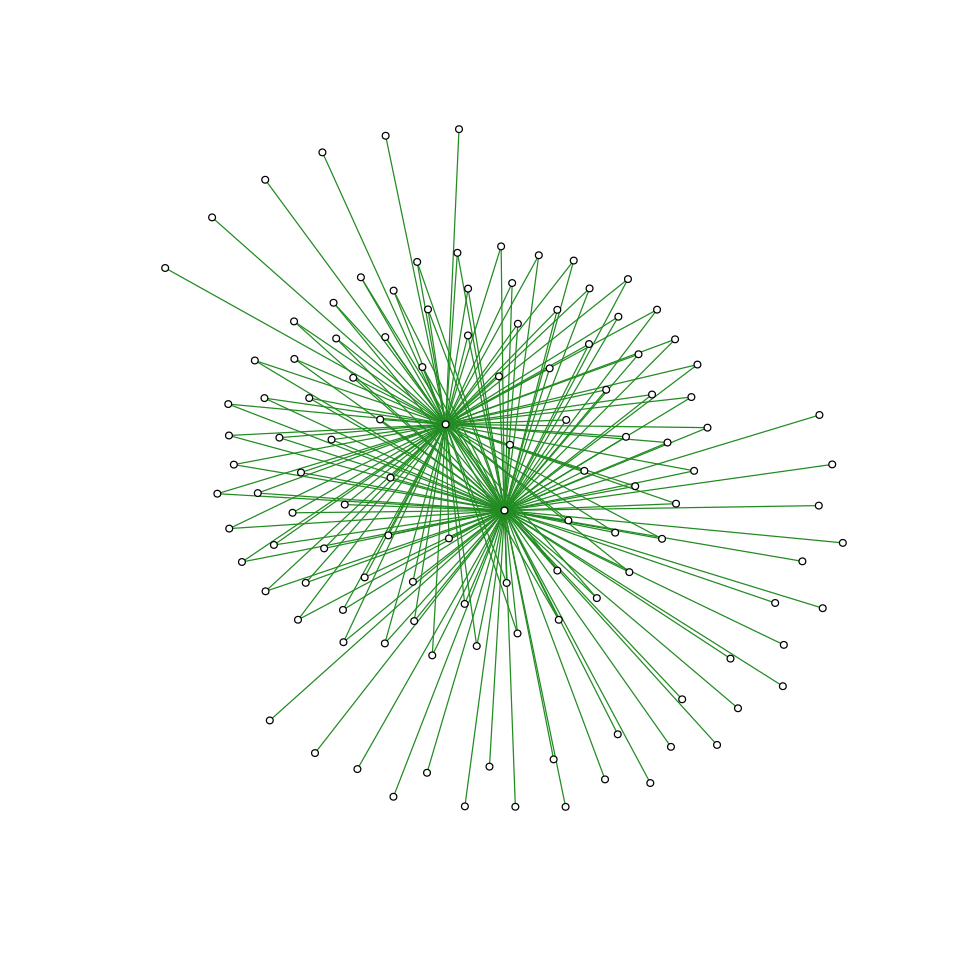

In [111]:
# Obtain network from propr object
# Filter edges with rho < 0.1
# Only include Mmassillii genera
propr_network = getNetwork(large_Otu_genus_propr, 
           cutoff = 0.10, 
           include = c("Methanomassiliicoccus", "Candidatus Methanomethylophilus"))

In [122]:
# Extract significanlty coocurring taxa with each Mmassilii
# All Edges have rho > 0.1

propr_network_Mmethyl = propr_network %>% 
    igraph::as_data_frame() %>%
    filter(from == "Candidatus Methanomethylophilus" | to == "Candidatus Methanomethylophilus")

col_co_Mmethyl = combined_Mmassilii %>% 
    filter(co_ca_Mmethyl == TRUE) %>%
    pull(Tax)

col_co_Mmassiliicoccus = combined_Mmassilii %>% 
    filter(co_Mmassiliicoccus == TRUE) %>%
    pull(Tax)


In [125]:
# Color the Mmassiliicoccus - ca Mmethyl edge
edge_colors = propr_network %>% 
    igraph::as_data_frame() %>%
    mutate(color = if_else(from %in% Mmassilii_genera & to %in% Mmassilii_genera,
                          "steelblue3", "lightblue")) %>%
    pull(color)


In [127]:
# Egde color alternative
# Color diiferently the Mmassiliicoccus and ca_Mmethyl edges with other taxa
edge_colors_2 = propr_network %>% 
    igraph::as_data_frame() %>%
    mutate(color = 
           case_when(from == "Candidatus Methanomethylophilus" | 
                      to == "Candidatus Methanomethylophilus" ~ "slategray2", 
           TRUE ~ color)) %>%
    mutate(color = 
           case_when(from == "Methanomassiliicoccus" | 
                     to == "Methanomassiliicoccus" ~ "slategray3", 
                     TRUE ~ color)) %>%
    mutate(color = 
           case_when(from %in% Mmassilii_genera & 
                     to %in% Mmassilii_genera ~ "turquoise", 
                     TRUE ~ color)) %>%
    pull(color)

In [128]:
# Egde color alternative
# Color edges that are coocurring AND proportional
edge_colors_3 = propr_network %>% 
    igraph::as_data_frame() %>%
    mutate(color = "lightblue") %>%
    mutate(color = 
           case_when((from == "Candidatus Methanomethylophilus" | to == "Candidatus Methanomethylophilus") &
                     ((from %in% col_co_Mmethyl) | (to %in% col_co_Mmethyl)) ~ "slategray", 
                     TRUE ~ color)) %>%
    mutate(color = 
           case_when((from == "Methanomassiliicoccus" | to == "Methanomassiliicoccus") & 
                     ((from %in% col_co_Mmassiliicoccus) | (to %in% col_co_Mmassiliicoccus)) ~ "slategray",
                     TRUE ~ color)) %>%
    pull(color)

In [129]:
# Edge width alternative
# Different width edges that are coocurring AND proportional
edge_widths = propr_network %>% 
    igraph::as_data_frame() %>%
    mutate(width = 1) %>%
    mutate(width = 
           case_when((from == "Candidatus Methanomethylophilus" | to == "Candidatus Methanomethylophilus") &
                     ((from %in% col_co_Mmethyl) | (to %in% col_co_Mmethyl)) ~ 4, 
                     TRUE ~ width)) %>%
    mutate(width = 
           case_when((from == "Methanomassiliicoccus" | to == "Methanomassiliicoccus") & 
                     ((from %in% col_co_Mmassiliicoccus) | (to %in% col_co_Mmassiliicoccus)) ~ 4,
                     TRUE ~ width)) %>%
    mutate(width = if_else(from %in% Mmassilii_genera & to %in% Mmassilii_genera,
                          4, width)) %>%
    pull(width)

In [132]:
# Change color of nodes
# Different color for Mmassilii genera, Archaea and TMA producers
propr_V = V(propr_network)
node_colors = case_when(propr_V$name %in% Archaea ~ "Navy",
                        propr_V$name == "Candidatus Methanomethylophilus" ~ "#dc6306ff", 
                        propr_V$name == "Methanomassiliicoccus" ~ "#1c9e77ff", 
                        propr_V$name %in% TMA_producers ~ "red",
                        TRUE ~ "lightgrey")

# Chage size of nodes
# Different size for Mmassilii genera and TMA producers
vertex_size = case_when(propr_V$name == "Candidatus Methanomethylophilus" ~ 6, 
                        propr_V$name == "Methanomassiliicoccus" ~ 6, 
                        propr_V$name %in% TMA_producers ~ 4, 
                        propr_V$name %in% Archaea ~ 4,
                        TRUE ~ 3)

In [133]:
# Change color of node border
# Different color for co-occurring with either Mmasilii, both or neither
node_border = case_when(propr_V$name %in% col_co_Mmassiliicoccus &
                            !(propr_V$name %in% col_co_Mmethyl) ~ "#1c9e77ff", 
                        propr_V$name %in% col_co_Mmethyl & 
                            !(propr_V$name %in% col_co_Mmassiliicoccus) ~ "#dc6306ff", 
                        propr_V$name %in% col_co_Mmassiliicoccus & 
                            propr_V$name %in% col_co_Mmethyl  ~ "plum3",
                        TRUE ~ "snow4")

In [134]:
# Vertex names
# Show only Mmassilii, TMA producers and Archaea
vertex_names = case_when(propr_V$name == "Candidatus Methanomethylophilus" ~ "Candidatus Methanomethylophilus", 
                         propr_V$name == "Methanomassiliicoccus" ~ "Methanomassiliicoccus", 
                         propr_V$name %in% TMA_producers ~ propr_V$name, 
                         propr_V$name %in% Archaea ~ propr_V$name,
                         TRUE ~ "")

In [135]:
# Other parameters
# Disable edges with radius
E(propr_network)$curved = 0 

# Edge thickness constant
#E(propr_network)$width = 2

# Define the frame and spacing for the plot
par(mai=c(0,0,1,0)) 

In [136]:
# Set parameters and plot
options(repr.plot.width = 10, repr.plot.height = 10)
plot_file = file.path(plots_dir, "Mmassilii_propr_network.svg")
svg(plot_file); plot(propr_network, 
     layout = layout.davidson.harel, 
     edge.color = edge_colors_2,
     edge.width = 1.5,
     vertex.color = node_colors,
     vertex.size = vertex_size,
     vertex.frame.color = "snow4",
     vertex.label = vertex_names, 
     vertex.label.family = "sans",
     vertex.label.cex = 0.7,
     vertex.shape = "circle",
     vertex.label.dist = 1,
     vertex.label.color = 'black',
     vertex.label.font = 2,
     vertex.label.cex = 1); dev.off()



png 
  2

In [ ]:
send_email("Coocurr_complete_dataset")

# Session Info

In [2]:
sessionInfo()

R version 3.5.1 (2018-07-02)
Platform: x86_64-conda_cos6-linux-gnu (64-bit)
Running under: Ubuntu 18.04.5 LTS

Matrix products: default
BLAS/LAPACK: /ebio/abt3_projects/software/miniconda3_gt4.4/envs/UpSetR_2/lib/R/lib/libRlapack.so

locale:
 [1] LC_CTYPE=en_US.UTF-8       LC_NUMERIC=C              
 [3] LC_TIME=en_US.UTF-8        LC_COLLATE=en_US.UTF-8    
 [5] LC_MONETARY=en_US.UTF-8    LC_MESSAGES=en_US.UTF-8   
 [7] LC_PAPER=en_US.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=en_US.UTF-8 LC_IDENTIFICATION=C       

attached base packages:
[1] stats     graphics  grDevices utils     datasets  methods   base     

other attached packages:
 [1] igraph_1.2.4.1        lmerTest_3.1-0        lme4_1.1-21          
 [4] Matrix_1.2-17         RColorBrewer_1.1-2    furrr_0.1.0          
 [7] future_1.14.0         cooccur_1.3           speedyseq_0.1.2.9004 
[10] phyloseq_1.26.1       cowplot_1.0.0         data.table_1.12.2

# Debug

In [ ]:
# # Write metadata table for manuscript
# curmet_complete = read_tsv("/ebio/abt3_projects/small_projects/jdelacuesta/public_data_retrieval/CurMetDat-metagenomes/files/metadata/Complete_CurMetDat.tsv")

# df1 = GM_metadata %>% dplyr::select(dataset_name, Sample, subjectID, country)
# df2 = curmet_complete %>% dplyr::select(dataset_name, sampleID, subjectID, country, NCBI_accession)
# df3 = left_join(df1, df2, by = c("Sample" = "sampleID", "dataset_name", "country", "subjectID"))

# dataset_name = c("AsnicarF_2017", "BackhedF_2015", "Bengtsson-PalmeJ_2015", "BritoIL_2016", "Castro-NallarE_2015", "ChngKR_2016", "ChengpingW_2017", "CosteaPI_2017", "DavidLA_2015", "DhakanDB_2019", "FengQ_2015", "FerrettiP_2018", "GopalakrishnanV_2018", "HanniganGD_2017", "HansenLBS_2018", "Heitz-BuschartA_2016", "HMP_2012", "JieZ_2017", "KarlssonFH_2013", "KieserS_2018", "KosticAD_2015", "LeChatelierE_2013", "LiJ_2014", "LiJ_2017", "LiSS_2016", "LiuW_2016", "LomanNJ_2013", "LoombaR_2017", "LouisS_2016", "MatsonV_2018", "NielsenHB_2014", "Obregon-TitoAJ_2015", "OhJ_2014", "OlmMR_2017", "PasolliE_2018", "PehrssonE_2016", "QinJ_2012", "QinN_2014", "RampelliS_2015", "RaymondF_2016", "SchirmerM_2016", "SmitSA_2017", "ShiB_2015", "TettAJ_2016", "TettAJ_2019_a", "TettAJ_2019_b", "TettAJ_2019_c", "ThomasAM_2018a", "ThomasAM_2018b", "VatanenT_2016", "VincentC_2016", "VogtmannE_2016", "XieH_2016", "YeZ_2018", "YuJ_2015", "Zeevi_2015", "ZellerG_2014", "Visconti_2019") 

# PMID = c("28144631", "25974306", "26259788", "27409808", "26336637", "27562258", "28750650", "29242367", "25991682", "30698687", "25758642", "30001516", "29097493", "30459201", "30425247", "27723761", "22699609", "29018189", "23719380", "29786169", "25662751", "23985870", "24997786", "28143587", "27126044", "27708392", "23571589", "28467925", "26919743", "29302014", "24997787", "25807110", "25279917", "28073918", "30661755", "27172044", "23023125", "25079328", "25981789", "26359913", "27984736", "28839072", "25691586", "28649415", "31607556", "31607556", "31607556", "30936548", "30936548", "27259157", "26975510", "27171425", "27818083", "30077182", "26408641", "26590418", "25432777", "31582752")

# pulication_info = data.frame(dataset_name, PMID)

# df_final = left_join(df3, pulication_info)

# write_tsv(df_final, "/ebio/abt3_projects/small_projects/jdelacuesta/scratchpad/vadin_doi.txt")